In [1]:
# update the git
! git add  .
! git commit -m "From Mac"
! git push

The file will have its original line endings in your working directory.
The file will have its original line endings in your working directory.
The file will have its original line endings in your working directory.
The file will have its original line endings in your working directory.


[master 53e34bae] From Mac
 4 files changed, 7660 insertions(+), 16 deletions(-)
 create mode 100644 NeuralNetwork/AAE/.ipynb_checkpoints/9a swiss roll-checkpoint.ipynb
 create mode 100644 NeuralNetwork/AAE/9a swiss roll.ipynb


To https://github.com/JaeDukSeo/Daily-Neural-Network-Practice-2
   1bbb2d0d..53e34bae  master -> master


In [2]:
# import library
import matplotlib 
matplotlib.use('Agg')
%matplotlib inline
import numpy as np
import sys, os,cv2
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder
from skimage.transform import resize
from scipy.misc import imread
from imgaug import augmenters as iaa
import nibabel as nib
import imgaug as ia
from scipy.ndimage import zoom
from sklearn.utils import shuffle
import matplotlib.animation as animation

# Generate training data
import tensorflow as tf
old_v = tf.logging.get_verbosity()
tf.logging.set_verbosity(tf.logging.ERROR)
from tensorflow.examples.tutorials.mnist import input_data

plt.style.use('seaborn-white')
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
np.random.seed(6278)
tf.set_random_seed(6728)
ia.seed(6278)

In [3]:
# get the mnist data set
mnist = input_data.read_data_sets('../../Dataset/MNIST/', one_hot=True)
x_data, train_label, y_data, test_label = mnist.train.images, mnist.train.labels, mnist.test.images, mnist.test.labels
x_data_added,x_data_added_label = mnist.validation.images,mnist.validation.labels
x_data = x_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
y_data = y_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
x_data_added = x_data_added.reshape(-1, 28, 28, 1)
x_data = np.vstack((x_data,x_data_added))
train_label = np.vstack((train_label,x_data_added_label))

train_batch = np.zeros((20000,28,28,1))
test_batch = np.zeros((10000,28,28,1))
for iter in range(20000):
    train_batch[iter,:,:,:] = np.expand_dims(resize(x_data[iter,:,:,0],(28,28)),axis=3)

# print out the data shape and the max and min value
print(train_batch.shape)
print(train_batch.max())
print(train_batch.min())
print(train_label.shape)
print(train_label.max())
print(train_label.min())
print(test_batch.shape)
print(test_batch.max())
print(test_batch.min())
print(test_label.shape)
print(test_label.max())
print(test_label.min())

Extracting ../../Dataset/MNIST/train-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/train-labels-idx1-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-labels-idx1-ubyte.gz


C:\ProgramData\Anaconda3\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
C:\ProgramData\Anaconda3\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: DeprecationWarning: Both axis > a.ndim and axis < -a.ndim - 1 are deprecated and will raise an AxisError in the future.
  


(20000, 28, 28, 1)
1.0
0.0
(60000, 10)
1.0
0.0
(10000, 28, 28, 1)
0.0
0.0
(10000, 10)
1.0
0.0


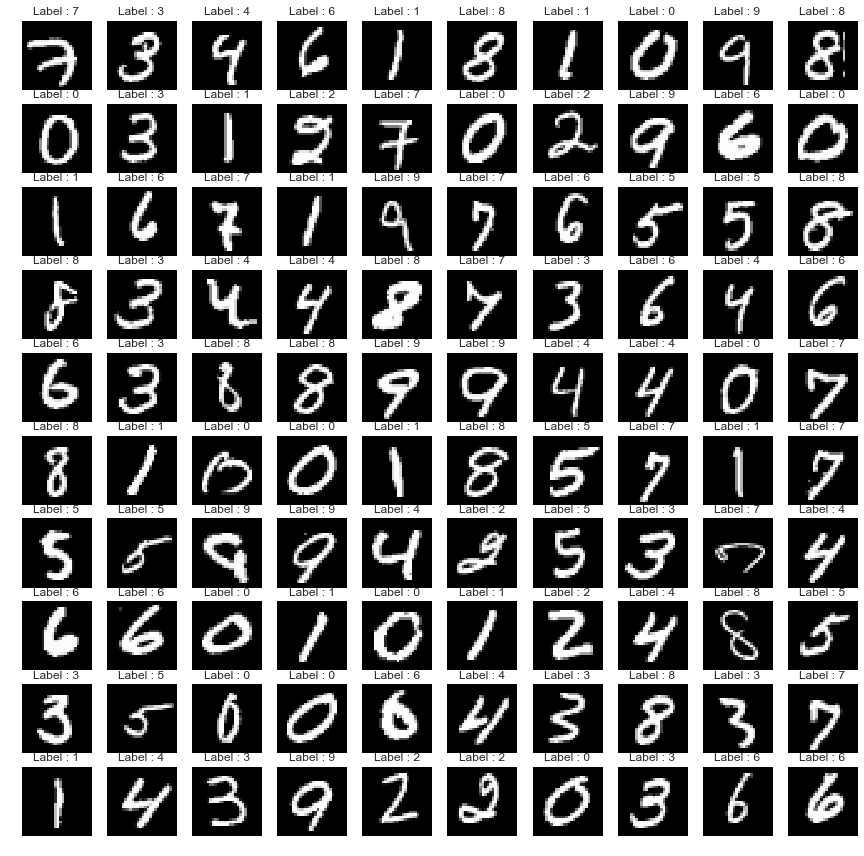

In [4]:
# show small amount of data
fig=plt.figure(figsize=(15, 15))
columns = 10 ; rows = 10
for i in range(1, columns*rows +1):
    fig.add_subplot(rows, columns, i)
    plt.imshow(np.squeeze(train_batch[i-1]),cmap='gray')
    plt.axis('off')
    plt.title("Label : "+str(np.argmax(train_label[i-1])))
plt.show()

In [70]:
# import all of the layers
def tf_elu(x):
    """ Exponential Linear Unit based on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : float
        The floating point number that is going to be applied to the ELU activation.

    Returns
    -------
    float
        Data with the same dimensions as the input after ELU

    """
    return tf.nn.elu(x)
def d_tf_elu(x):
    """Derivative of the Exponential Linear Unit base on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : type
        Description of parameter `x`.

    Returns
    -------
    type
        Description of returned object.

    """

    return tf.cast(tf.greater(x,0),tf.float32)  + (tf_elu(tf.cast(tf.less_equal(x,0),tf.float32) * x) + 1.0)

def tf_identiy(x)  : return x
def d_tf_identiy(x): return tf.ones_like(x,dtype=tf.float32)

def tf_relu(x):   return tf.nn.relu(x)
def d_tf_relu(x): return tf.cast(tf.greater(x,0.0),tf.float32)

def tf_lrelu(x): return tf.nn.leaky_relu(x,alpha=0.2)
def d_tf_lrelu(x): return tf.cast(tf.greater(x,0),tf.float32) + tf.cast(tf.less_equal(x,0),tf.float32) * 0.2

def tf_tanh(x): return tf.nn.tanh(x)
def d_tf_tanh(x): return 1 - tf_tanh(x) ** 2

def tf_sigmoid(x):   return tf.nn.sigmoid(x)
def d_tf_sigmoid(x): return tf_sigmoid(x) * (1.0-tf_sigmoid(x))

def tf_atan(x): return tf.atan(x)
def d_tf_atan(x): return 1.0/(1.0 + x**2)

def tf_softmax(x): return tf.nn.softmax(x)
def softabs(x): return tf.sqrt(x ** 2 + 1e-20)

def tf_logcosh(x): return tf.log(tf.cosh(x))
def d_tf_logcosh(x): return tf.tanh(x)

class FNN():

    def __init__(self,inc,outc,stddev=None,act=tf_elu,d_act=d_tf_elu,which_reg=0,init_x=False):
        if init_x:
            interval = np.sqrt(6.0 / (inc + outc + 1.0))
            self.w = tf.Variable(tf.random_uniform(shape=(inc, outc),minval=-interval,maxval=interval,dtype=tf.float32,seed=2))
            self.b = tf.Variable(tf.zeros(shape=[outc],dtype=tf.float32))
        else:
            self.w = tf.Variable(tf.random_normal([inc,outc],stddev=stddev,seed=2,dtype=tf.float32))
            self.b = tf.Variable(tf.zeros([outc],dtype=tf.float32))

        self.m,  self.v   = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.m_b,self.v_b = tf.Variable(tf.zeros_like(self.b)),tf.Variable(tf.zeros_like(self.b))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg

    def getw(self): return self.w

    def feedforward(self,input=None):
        self.input  = input
        self.layer  = tf.matmul(input,self.w) + self.b
        self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient=None,learning_rate=None):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2
        grad  = tf.matmul(tf.transpose(grad_part_3),grad_middle)/batch_size
        grad_b= tf.reduce_mean(grad_middle,0)/batch_size
        grad_pass = tf.matmul(grad_middle,tf.transpose(self.w))

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1.-beta1)
        v_hat = self.v / (1.-beta2)
        adam_middle  = m_hat     *  learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,adam_middle )))

        update_w.append(tf.assign(self.m_b,self.m_b*beta1 + (1-beta1) * (grad_b)   ))
        update_w.append(tf.assign(self.v_b,self.v_b*beta2 + (1-beta2) * (grad_b ** 2)   ))
        m_hat_b = self.m_b / (1-beta1)
        v_hat_b = self.v_b / (1-beta2)
        adam_middle_b = m_hat_b *  learning_rate/(tf.sqrt(v_hat_b) + adam_e)
        update_w.append(tf.assign(self.b,tf.subtract(self.b,adam_middle_b ))) 
        
        return grad_pass,update_w

class CNN():

    def __init__(self,k,inc,out,stddev=0.005,which_reg=0,act=tf_elu,d_act=d_tf_elu,residual=False):
        self.w = tf.Variable(tf.random_normal([k,k,inc,out],stddev=stddev,seed=2,dtype=tf.float32))
        self.m,self.v = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg
        self.residual = residual

    def getw(self): return self.w

    def feedforward(self,input,stride=1,padding='VALID'):
        self.input  = input
        if self.residual: 
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding='SAME')
            self.layerA = self.act(self.layer) + input
        else:
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding=padding)
            self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient,stride=1,padding='VALID'):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2

        if self.residual: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) / batch_size
            
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) + gradient
        else: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            ) / batch_size
        
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            )

        # === Reg ===        
        if self.which_reg == 0:
            grad = grad

        if self.which_reg == 0.5:
            grad = grad + lamda * (tf.sqrt(tf.abs(self.w))) * (1.0/tf.sqrt(tf.abs(self.w)+ 10e-5)) * tf.sign(self.w)

        if self.which_reg == 1:
            grad = grad + lamda * tf.sign(self.w)

        if self.which_reg == 1.5:
            grad = grad + lamda * 1.0/(tf.sqrt(tf.square(self.w) + 10e-5)) * self.w

        if self.which_reg == 2:
            grad = grad + lamda * (1.0/tf.sqrt(tf.square(tf.abs(self.w))+ 10e-5)) * tf.abs(self.w) * tf.sign(self.w)

        if self.which_reg == 2.5:
            grad = grad + lamda * 2.0 * self.w

        if self.which_reg == 3:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),3)+ 10e-5,-0.66) * tf.pow(tf.abs(self.w),2) * tf.sign(self.w)

        if self.which_reg == 4:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),4)+ 10e-5,-0.75) * tf.pow(tf.abs(self.w),3) * tf.sign(self.w)

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1-beta1)
        v_hat = self.v / (1-beta2)
        adam_middel = learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,tf.multiply(adam_middel,m_hat)  )))
        return grad_pass,update_w

In [71]:
# hyper class
num_epoch = 10001; batch_size = 500; print_size = 50; lamda = 0.0
beta1,beta2,adam_e = 0.9,0.999,1e-8; eps = 1e-10

aimed_range = tf.placeholder(shape=[],dtype=tf.float32)

e1 = FNN(784,1000,       stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e3 = FNN(1000,2,         stddev=0.005,which_reg=0,act=tf_identiy,d_act=d_tf_identiy)

d1 = FNN(2,1000,         stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d3 = FNN(1000,784,       stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

discrim1 = FNN(2,1000   ,stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
discrim2 = FNN(1000,1000,stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
discrim3 = FNN(1000,1   ,stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

# 0.00005
def norm_vec(x,aimed_range):
    return ((x-tf.reduce_min(x,1)[:,None]) /(tf.reduce_max(x,1)-tf.reduce_min(x,1))[:,None]) *\
           (aimed_range + aimed_range) - aimed_range

In [72]:
# 0. Update the encoding and decoding
x0  = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr0 = tf.placeholder(shape=[],dtype=tf.float32)

elayer1 = e1.feedforward(x0)
elayer2 = e2.feedforward(elayer1)
elayer3 = e3.feedforward(elayer2)

dlayer1 = d1.feedforward(elayer3)
dlayer2 = d2.feedforward(dlayer1)
dlayer3 = d3.feedforward(dlayer2)

recon_cost = -tf.reduce_mean(x0*tf.log(dlayer3+10e-10)+ (1.0-x0)*tf.log(1.0-dlayer3+10e-10))
# auto_train = tf.train.AdamOptimizer(learning_rate=lr0).minimize(recon_cost)
recon_ = (-(x0/(dlayer3+10e-10)) + (1.0-x0)/(1.0-dlayer3+10e-10))/(batch_size)


dgrad3,dgrad3_up = d3.backprop(norm_vec(recon_,aimed_range)+recon_,learning_rate=lr0)
dgrad2,dgrad2_up = d2.backprop(norm_vec(dgrad3,aimed_range)+dgrad3,learning_rate=lr0)
dgrad1,dgrad1_up = d1.backprop(norm_vec(dgrad2,aimed_range)+dgrad2,learning_rate=lr0)

egrad3,egrad3_up = e3.backprop(norm_vec(dgrad1,aimed_range)+dgrad1,learning_rate=lr0)
egrad2,egrad2_up = e2.backprop(norm_vec(egrad3,aimed_range)+egrad3,learning_rate=lr0)
egrad1,egrad1_up = e1.backprop(norm_vec(egrad2,aimed_range)+egrad2,learning_rate=lr0)

grad0_update = dgrad3_up + dgrad2_up + dgrad1_up + egrad3_up + egrad2_up + egrad1_up

In [73]:
# 1. Update the discrimator (with encode)
x1       = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr1      = tf.placeholder(shape=[],dtype=tf.float32)
x1_label = tf.zeros((batch_size,1),dtype=tf.float32)

elayer1_dis = e1.feedforward(x1)
elayer2_dis = e2.feedforward(elayer1_dis)
elayer3_dis = e3.feedforward(elayer2_dis)

dislayer1_dis1= discrim1.feedforward(elayer3_dis)
dislayer2_dis1= discrim2.feedforward(dislayer1_dis1)
dislayer3_dis1= discrim3.feedforward(dislayer2_dis1)

dis_cost1 = - tf.reduce_mean(x1_label * tf.log(dislayer3_dis1 + 10e-10) + (1.-x1_label) * tf.log(1.-dislayer3_dis1+10e-10))
dis_grad1 = (-(x1_label/(dislayer3_dis1+10e-10)) + (1.0-x1_label)/(1.0-dislayer3_dis1+10e-10))/(batch_size)

disgrad31,disgrad31_up = discrim3.backprop(dis_grad1,learning_rate=lr1)
disgrad21,disgrad21_up = discrim2.backprop(disgrad31,learning_rate=lr1)
disgrad11,disgrad11_up = discrim1.backprop(disgrad21,learning_rate=lr1)

grad1_update = disgrad31_up + disgrad21_up + disgrad11_up

In [74]:
# 2. Update the discrimator (with prior)
x2       = tf.placeholder(shape=[batch_size,2],dtype=tf.float32)
lr2      = tf.placeholder(shape=[],dtype=tf.float32)
x2_label = tf.ones((batch_size,1),dtype=tf.float32)

dislayer1_dis2= discrim1.feedforward(x2)
dislayer2_dis2= discrim2.feedforward(dislayer1_dis2)
dislayer3_dis2= discrim3.feedforward(dislayer2_dis2)

dis_cost2 = - tf.reduce_mean(x2_label * tf.log(dislayer3_dis2 + 10e-10) + (1.-x2_label) * tf.log(1.-dislayer3_dis2+10e-10))
dis_grad2 = (-(x2_label/(dislayer3_dis2+10e-10)) + (1.0-x2_label)/(1.0-dislayer3_dis2+10e-10))/(batch_size)

disgrad32,disgrad32_up = discrim3.backprop(dis_grad2,learning_rate=lr2)
disgrad22,disgrad22_up = discrim2.backprop(disgrad32,learning_rate=lr2)
disgrad12,disgrad12_up = discrim1.backprop(disgrad22,learning_rate=lr2)

grad2_update = disgrad32_up + disgrad22_up + disgrad12_up

In [75]:
# 3. update the generator here 
x3       = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr3      = tf.placeholder(shape=[],dtype=tf.float32)
x3_label = tf.ones((batch_size,1),dtype=tf.float32)

elayer13 = e1.feedforward(x3)
elayer23 = e2.feedforward(elayer13)
elayer33 = e3.feedforward(elayer23)

dlayer13 = discrim1.feedforward(elayer33)
dlayer23 = discrim2.feedforward(dlayer13)
dlayer33 = discrim3.feedforward(dlayer23)

fake_cost = - tf.reduce_mean(x3_label * tf.log(dlayer33 + 10e-10) + (1.-x3_label) * tf.log(1.-dlayer33+10e-10))
fake_grad = (-(x3_label/(dlayer33+10e-10)) + (1.0-x3_label)/(1.0-dlayer33+10e-10))/(batch_size)

fake_disgrad3,_ = discrim3.backprop(fake_grad,learning_rate=lr3)
fake_disgrad2,_ = discrim2.backprop(fake_disgrad3,learning_rate=lr3)
fake_disgrad1,_ = discrim1.backprop(fake_disgrad2,learning_rate=lr3)

fake_egrad3,fake_egrad3_up = e3.backprop(norm_vec(fake_disgrad1,aimed_range)+fake_disgrad1,learning_rate=lr3)
fake_egrad2,fake_egrad2_up = e2.backprop(norm_vec(fake_egrad3,aimed_range)+fake_egrad3  ,learning_rate=lr3)
fake_egrad1,fake_egrad1_up = e1.backprop(norm_vec(fake_egrad2,aimed_range)+fake_egrad2  ,learning_rate=lr3)

fake_grad_update = fake_egrad3_up + fake_egrad2_up + fake_egrad1_up

In [ ]:
# start the session noise=.05
try:
    sess.run(tf.global_variables_initializer())
except:
    sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())
train_batch_shuffled = train_batch.copy()
color_dict = {0:'red',1:'blue',2:'green',3:'yellow',4:'purple',5:'grey',6:'black',7:'violet',8:'silver',9:'cyan'}
from sklearn import manifold, datasets

#                     00005
aimed_range_start = 0.00005
for iter in range(num_epoch):
    for current_data_index in range(0,len(train_batch),batch_size):
        prior_z,_    =  datasets.make_circles(n_samples=batch_size, factor=.2,noise=.05)
        prior_z = prior_z * 10
        current_data = train_batch_shuffled[current_data_index:current_data_index+batch_size].astype(np.float32)
    
        sess_result0 = sess.run([recon_cost,grad0_update],
        feed_dict={x0:current_data.reshape((batch_size,-1)),lr0:0.00008,aimed_range:aimed_range_start
        })

        sess_result1 = sess.run([dis_cost1,grad1_update],
        feed_dict={x1:current_data.reshape((batch_size,-1)),lr1:0.0001})

        sess_result2 = sess.run([dis_cost2,grad2_update],
        feed_dict={x2:prior_z                              ,lr2:0.0001})
        
        sess_result3 = sess.run([fake_cost,fake_grad_update],
        feed_dict={x3:current_data.reshape((batch_size,-1)),lr3:0.00008,aimed_range:aimed_range_start
                  })

        sys.stdout.write('\r iter: ' + str(iter) + ' batch: ' + str(current_data_index) + ' range: ' + str(aimed_range_start) + \
            ' recon cost: ' + str(sess_result0[0]) + \
            ' zero cost: ' + str(sess_result1[0]) + '\t\t\t\t\t\t\t\t' + \
            ' one  cost: ' + str(sess_result2[0]) + \
            ' fake cost: ' + str(sess_result3[0]) 
        ); sys.stdout.flush()
        
    aimed_range_start = aimed_range_start * 0.6
    if iter % print_size == 0:
        random_idx = np.random.permutation(len(train_batch_shuffled))
        temp_data  = train_batch_shuffled[random_idx][:batch_size].reshape((batch_size,-1))
#         sess_result = sess.run(dlayer3,
#                       feed_dict={x0:temp_data }).reshape((batch_size,28,28))
#         fig=plt.figure(figsize=(15, 15)); columns = 10 ; rows = 1
#         for i in range(1, columns*rows +1):
#             fig.add_subplot(rows, columns, i)
#             if i % 2 ==0 :
#                   plt.imshow(np.squeeze(sess_result[i-2]),cmap='gray')
#             else:
#                 plt.imshow(np.squeeze(temp_data[i-1]).reshape((28,28)),cmap='gray')
#             plt.axis('off')
#         plt.show()
        
        # Show the latent space        
        all_latent_vectors = sess.run(elayer33,feed_dict={x3:train_batch[:batch_size].reshape((batch_size,-1))})
        for current_batch_index in range(batch_size,len(train_batch), batch_size):
            current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
            sess_results = sess.run(elayer33,feed_dict={x3:current_train_data.reshape((batch_size,-1))})
            all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
        fig = plt.figure(figsize=(10,10))
        color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
        plt.title(str(color_dict))
        plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
        plt.scatter(prior_z[:,0],prior_z[:,1],marker='^')
        plt.xlim(-15,15);plt.ylim(-15,15);
        plt.grid();plt.savefig('./temp/'+str(iter)+'.png')
        plt.close('all')

 iter: 0 batch: 19500 range: 5e-05 recon cost: 0.3226341 zero cost: 0.30139458								 one  cost: 0.30705395 fake cost: 1.467488246

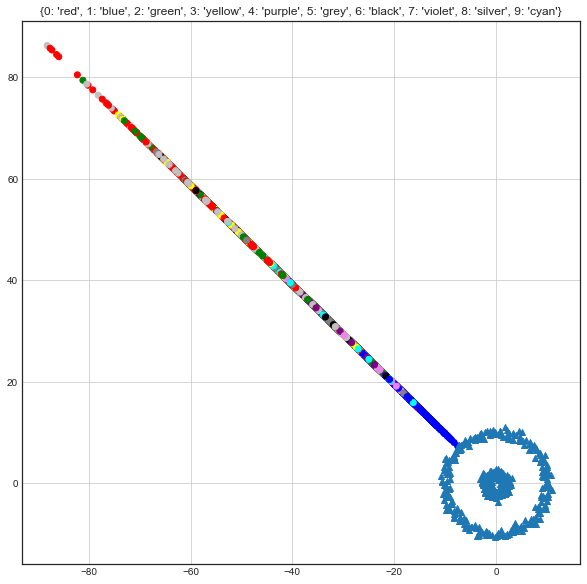

 iter: 10 batch: 19500 range: 1.7433922005000008e-05 recon cost: 0.25010806 zero cost: 0.080833614								 one  cost: 0.09764693 fake cost: 4.27066234

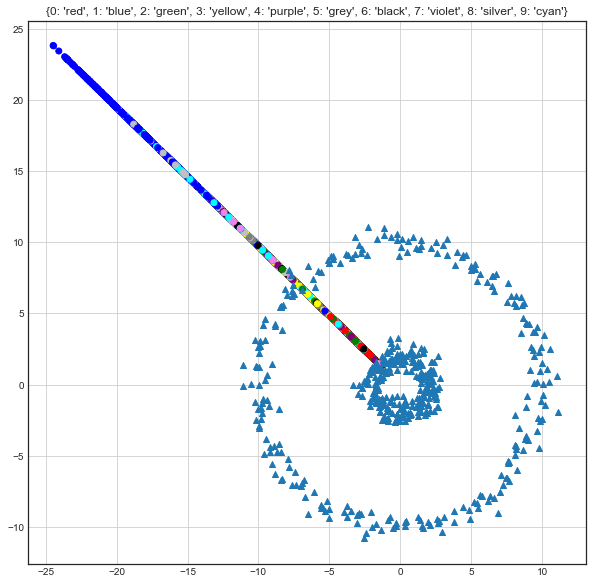

 iter: 20 batch: 19500 range: 6.078832729528469e-06 recon cost: 0.24492012 zero cost: 0.22255443								 one  cost: 0.37425774 fake cost: 2.9166465677

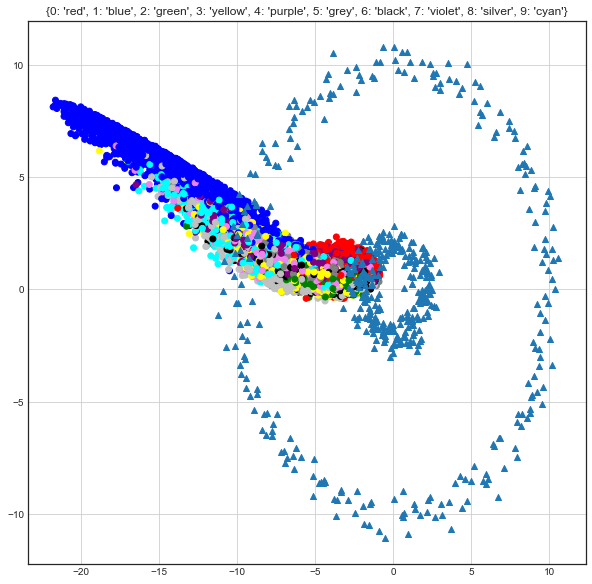

 iter: 30 batch: 19500 range: 2.119557913760812e-06 recon cost: 0.23530994 zero cost: 0.21297318								 one  cost: 0.41147473 fake cost: 1.96037164

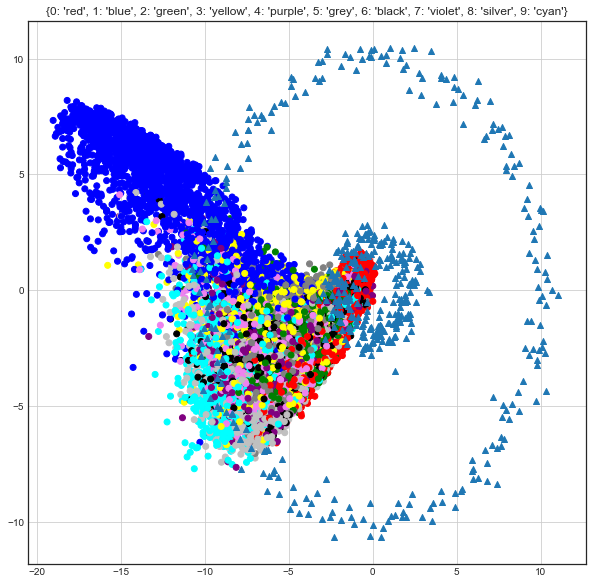

 iter: 40 batch: 19500 range: 7.390441470717303e-07 recon cost: 0.2261037 zero cost: 0.5030664								 one  cost: 0.52419645 fake cost: 1.0080642964

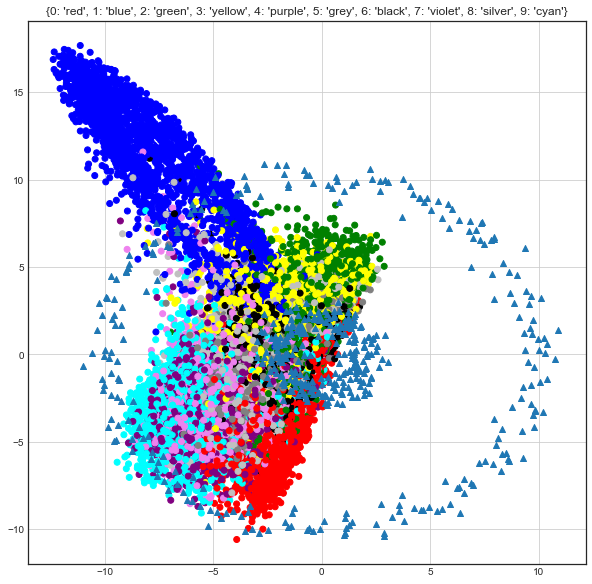

 iter: 50 batch: 19500 range: 2.57688760366006e-07 recon cost: 0.21903507 zero cost: 0.53675395								 one  cost: 0.5420619 fake cost: 0.90899735676

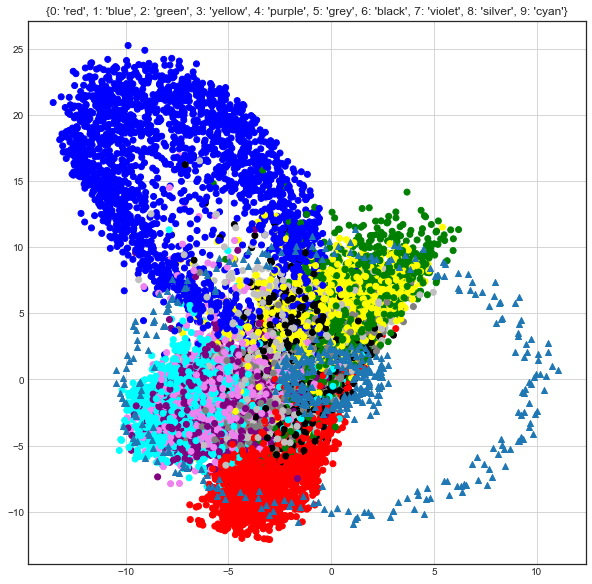

 iter: 60 batch: 19500 range: 8.985051499572169e-08 recon cost: 0.21269862 zero cost: 0.5486378								 one  cost: 0.60028356 fake cost: 0.8905003763

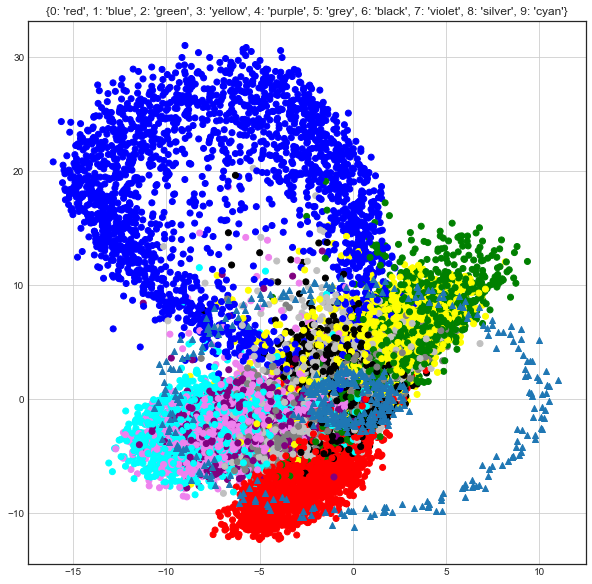

 iter: 70 batch: 19500 range: 3.132893741088991e-08 recon cost: 0.2062681 zero cost: 0.524554								 one  cost: 0.6446357 fake cost: 0.936719597857

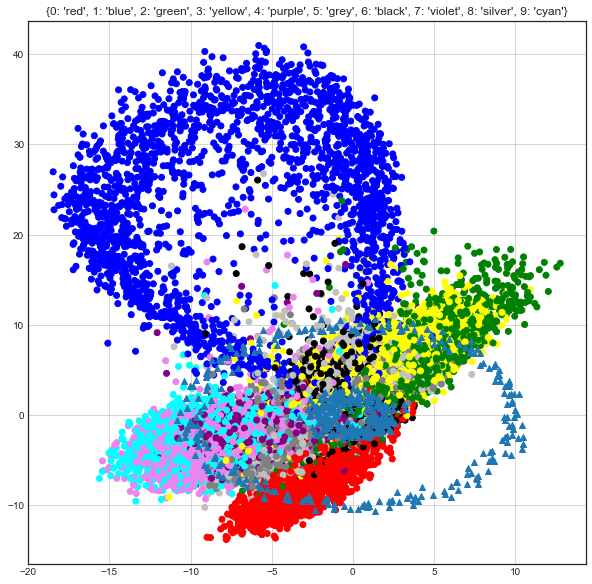

 iter: 80 batch: 19500 range: 1.092372502641963e-08 recon cost: 0.20259368 zero cost: 0.49568364								 one  cost: 0.67310476 fake cost: 1.004382757

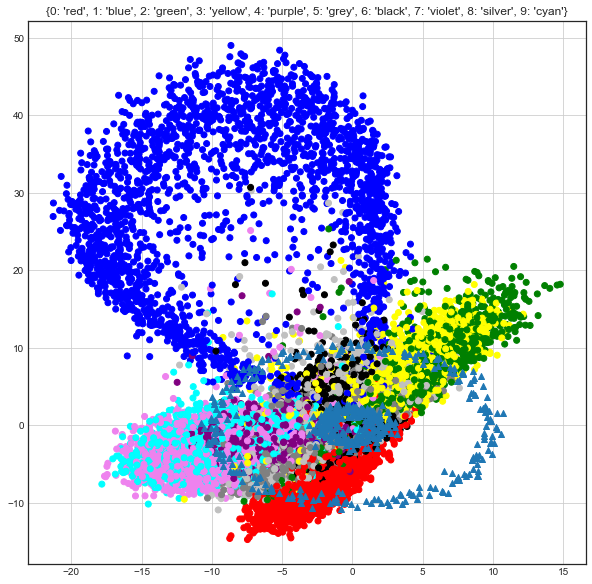

 iter: 90 batch: 19500 range: 3.808867402293329e-09 recon cost: 0.20037563 zero cost: 0.48747432								 one  cost: 0.68103397 fake cost: 1.04018957

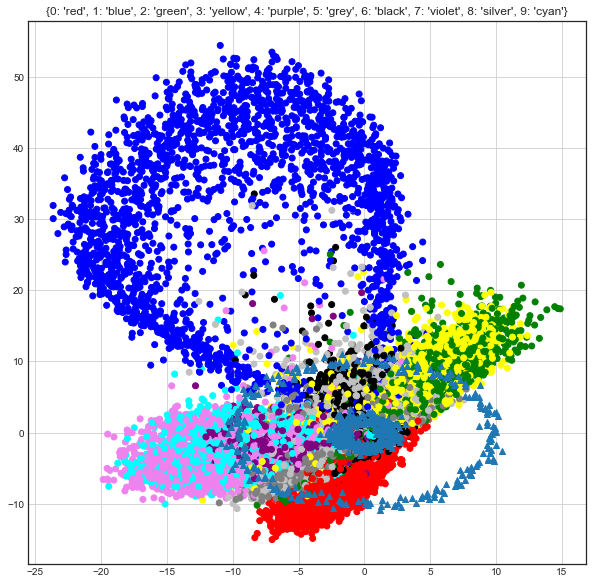

 iter: 100 batch: 19500 range: 1.3280699443793774e-09 recon cost: 0.19865246 zero cost: 0.49210215								 one  cost: 0.6846941 fake cost: 1.05839742

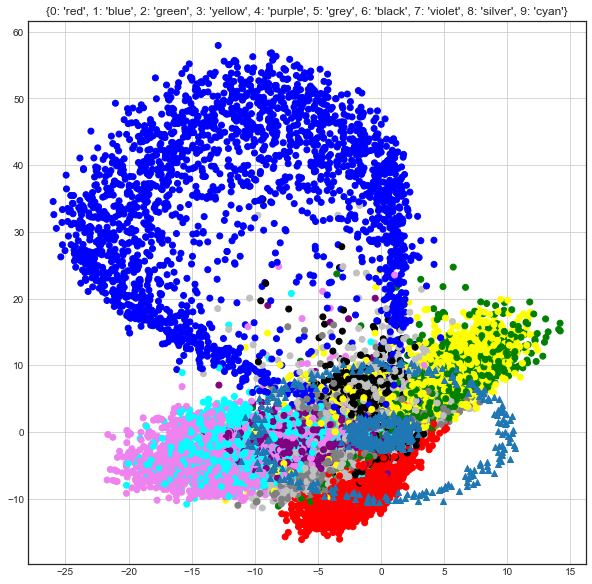

 iter: 110 batch: 19500 range: 4.630693565498952e-10 recon cost: 0.19721027 zero cost: 0.48609635								 one  cost: 0.6964327 fake cost: 1.081412794

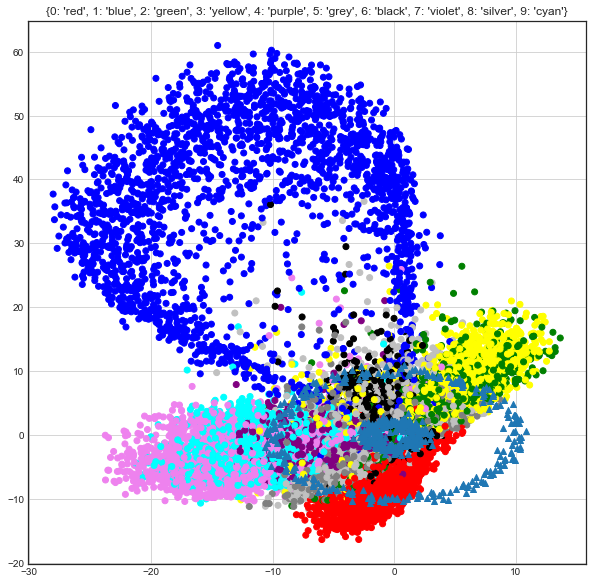

 iter: 120 batch: 19500 range: 1.6146230089992821e-10 recon cost: 0.19609773 zero cost: 0.48452842								 one  cost: 0.6933966 fake cost: 1.097587585

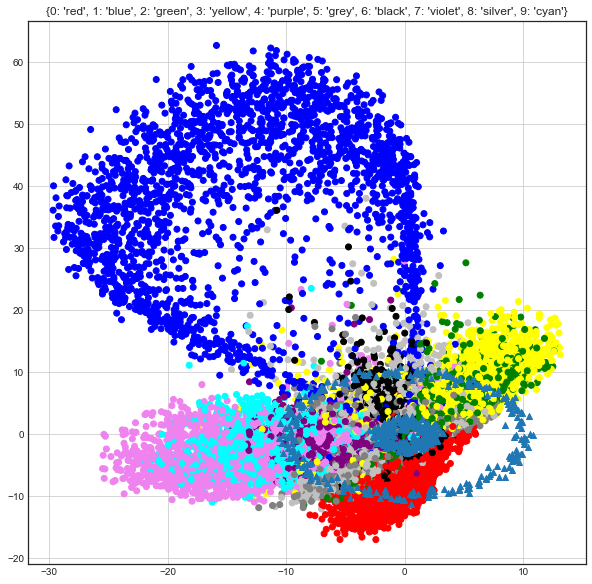

 iter: 130 batch: 19500 range: 5.6298423212743825e-11 recon cost: 0.19498768 zero cost: 0.4939269								 one  cost: 0.6938315 fake cost: 1.100907755

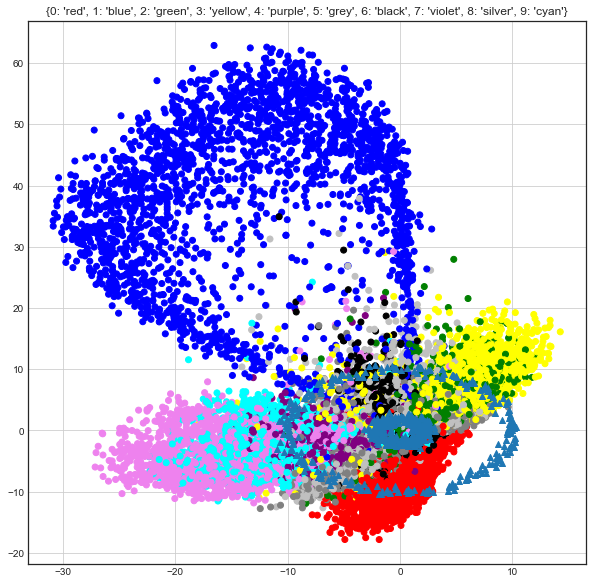

 iter: 140 batch: 19500 range: 1.963004638590915e-11 recon cost: 0.19405262 zero cost: 0.49034902								 one  cost: 0.6961401 fake cost: 1.115393896

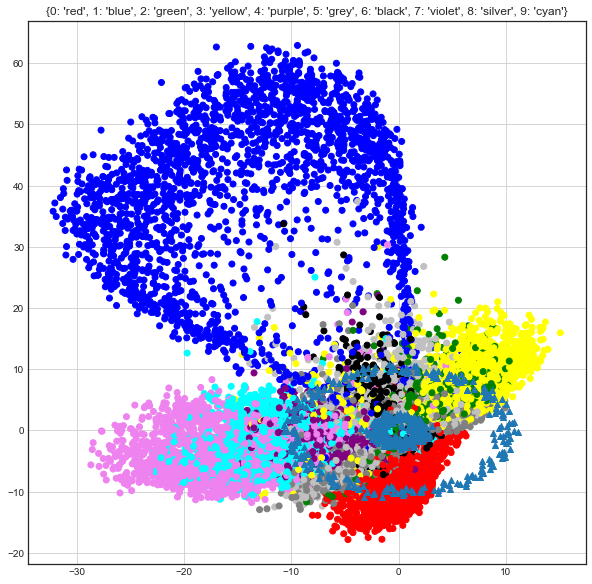

 iter: 150 batch: 19500 range: 6.844573952929447e-12 recon cost: 0.19340952 zero cost: 0.50138324								 one  cost: 0.69587547 fake cost: 1.111777155

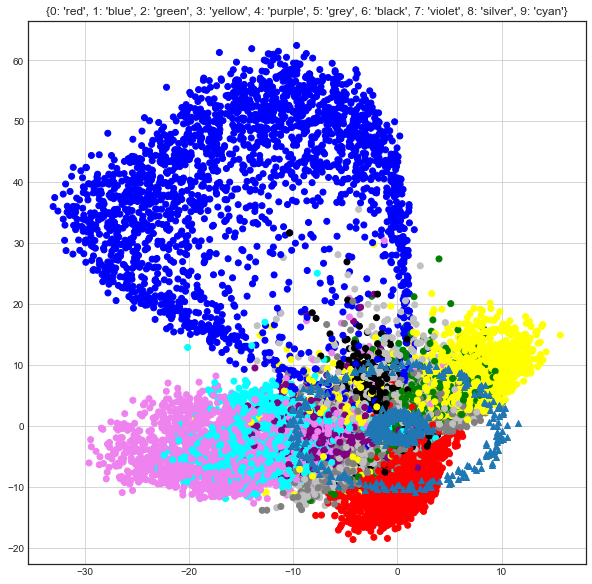

 iter: 160 batch: 19500 range: 2.386555369056531e-12 recon cost: 0.19237831 zero cost: 0.5001457								 one  cost: 0.6955478 fake cost: 1.121603321

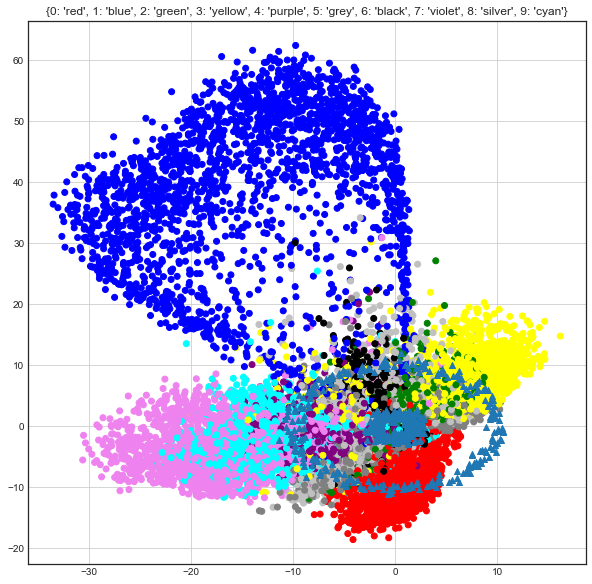

 iter: 170 batch: 19500 range: 8.321404032949113e-13 recon cost: 0.19156446 zero cost: 0.5076741								 one  cost: 0.6903972 fake cost: 1.12076789453

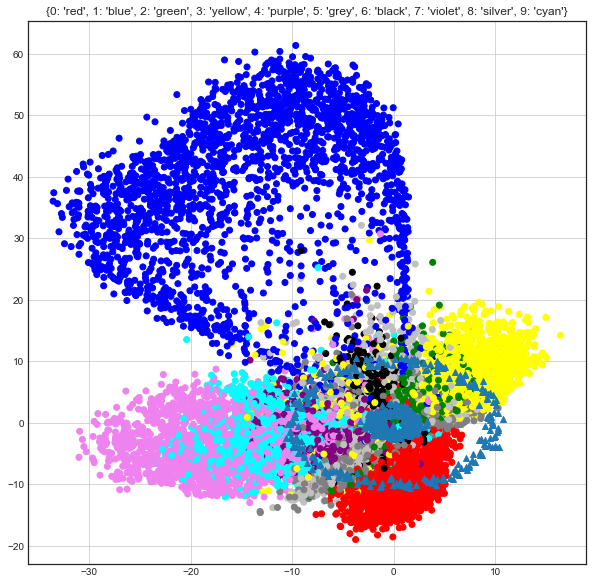

 iter: 180 batch: 19500 range: 2.901494177650546e-13 recon cost: 0.1909049 zero cost: 0.51307774								 one  cost: 0.6882103 fake cost: 1.1253164086

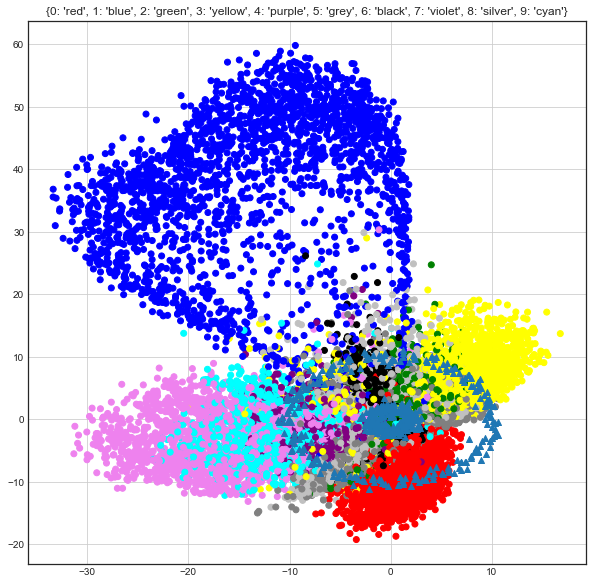

 iter: 190 batch: 19500 range: 1.0116884638224247e-13 recon cost: 0.19023983 zero cost: 0.51274294								 one  cost: 0.68779045 fake cost: 1.13730854

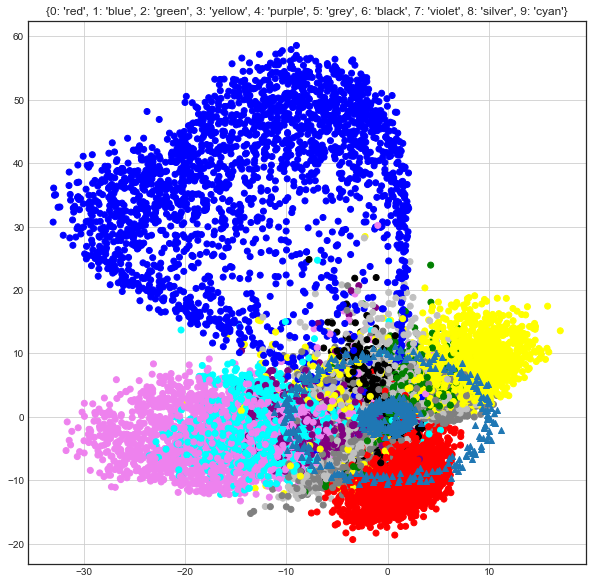

 iter: 200 batch: 19500 range: 3.527539554327684e-14 recon cost: 0.18955211 zero cost: 0.5181739								 one  cost: 0.68643266 fake cost: 1.141835247

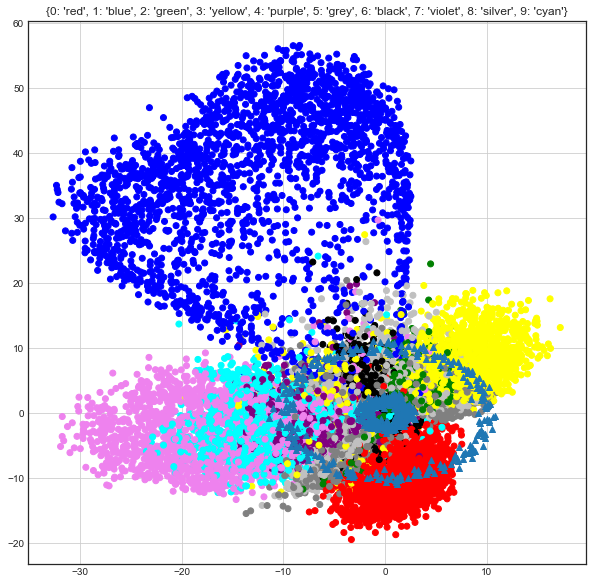

 iter: 210 batch: 19500 range: 1.2299769891940264e-14 recon cost: 0.18923874 zero cost: 0.5189796								 one  cost: 0.68893534 fake cost: 1.14074054

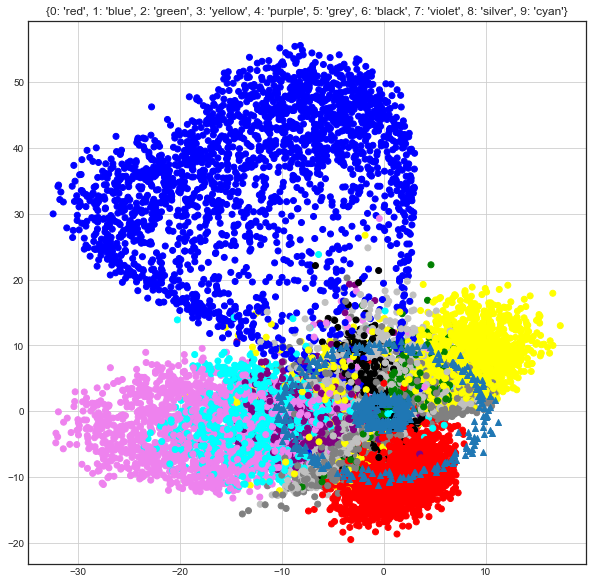

 iter: 220 batch: 19500 range: 4.288664579510677e-15 recon cost: 0.18832187 zero cost: 0.5271277								 one  cost: 0.68182933 fake cost: 1.1338214724

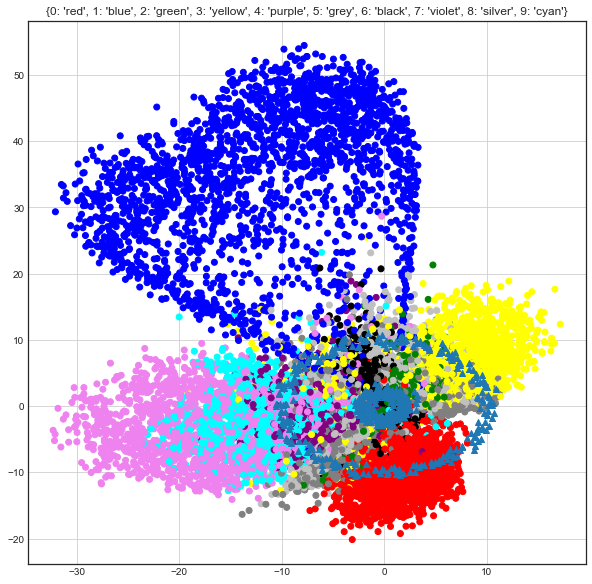

 iter: 230 batch: 19500 range: 1.4953648756959057e-15 recon cost: 0.18787552 zero cost: 0.52957743								 one  cost: 0.6800883 fake cost: 1.13573444

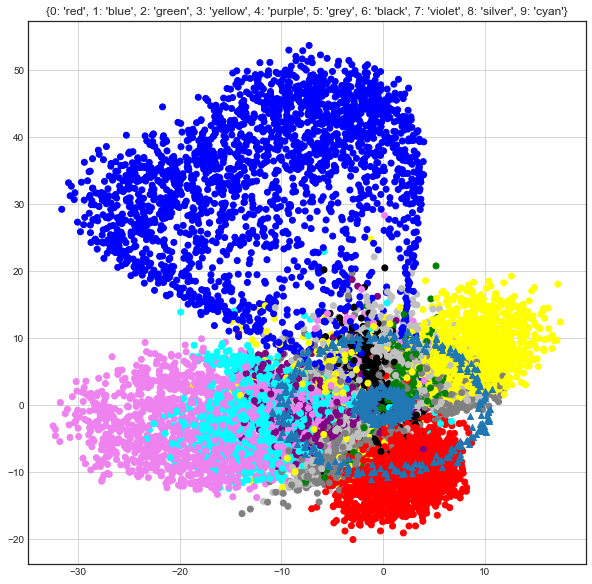

 iter: 240 batch: 19500 range: 5.21401492237979e-16 recon cost: 0.18746735 zero cost: 0.5373483								 one  cost: 0.6725965 fake cost: 1.13193275648

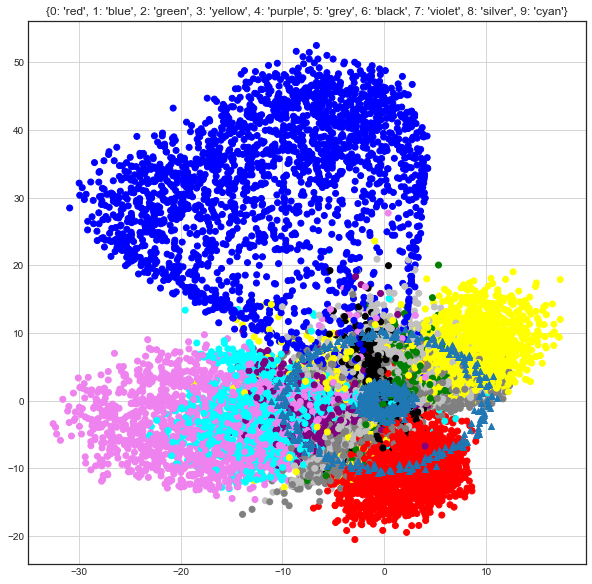

 iter: 250 batch: 19500 range: 1.818014589793508e-16 recon cost: 0.18685263 zero cost: 0.5411264								 one  cost: 0.6700731 fake cost: 1.1322238725

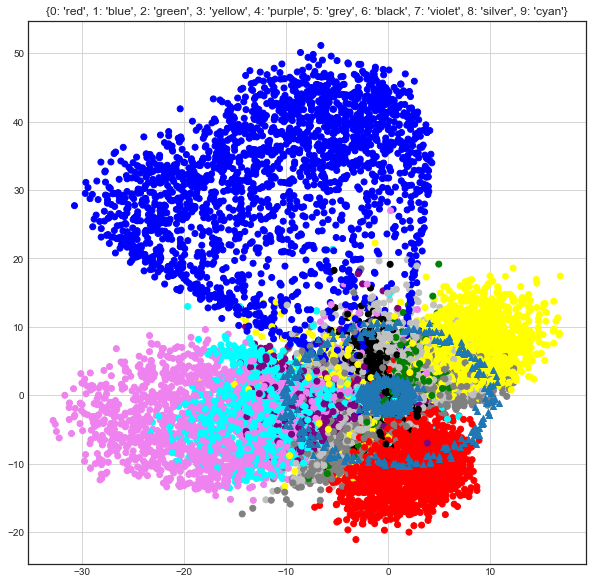

 iter: 260 batch: 19500 range: 6.33902491248242e-17 recon cost: 0.18676034 zero cost: 0.54598105								 one  cost: 0.6665478 fake cost: 1.12820364165

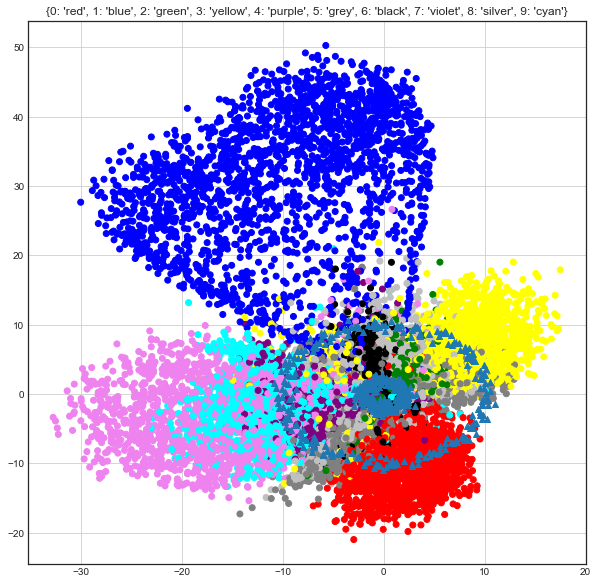

 iter: 270 batch: 19500 range: 2.21028131823941e-17 recon cost: 0.18597122 zero cost: 0.5541423								 one  cost: 0.66091466 fake cost: 1.1231284574

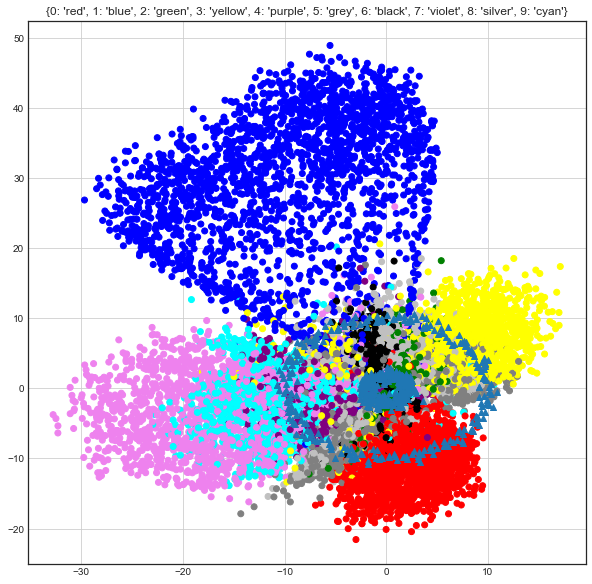

 iter: 280 batch: 19500 range: 7.706774422258894e-18 recon cost: 0.18564537 zero cost: 0.55638164								 one  cost: 0.65406173 fake cost: 1.11980586

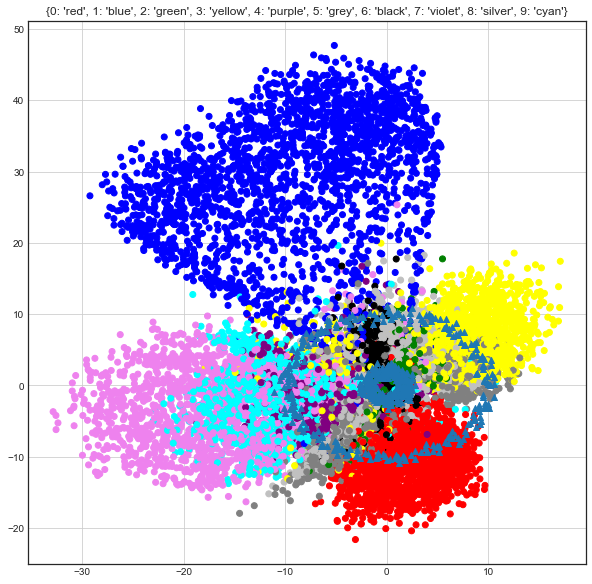

 iter: 290 batch: 19500 range: 2.6871860837558107e-18 recon cost: 0.18514995 zero cost: 0.56214505								 one  cost: 0.64499533 fake cost: 1.1127374

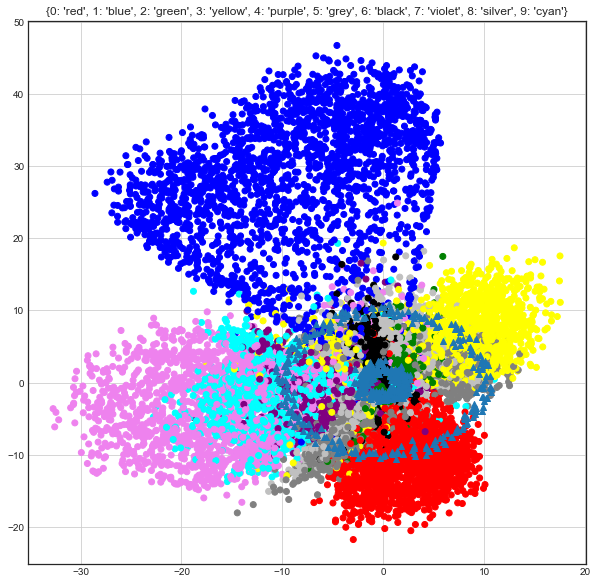

 iter: 300 batch: 19500 range: 9.369638519424043e-19 recon cost: 0.18489972 zero cost: 0.56015456								 one  cost: 0.6447378 fake cost: 1.1201259567

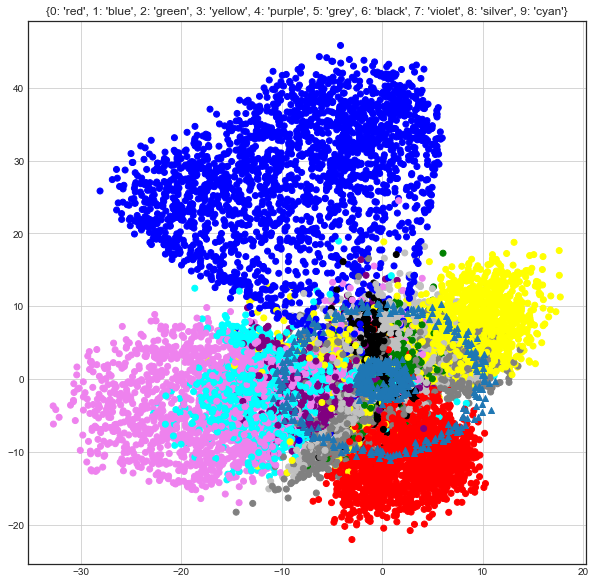

 iter: 310 batch: 19500 range: 3.2669909432536504e-19 recon cost: 0.18444763 zero cost: 0.5656447								 one  cost: 0.6390266 fake cost: 1.113638935

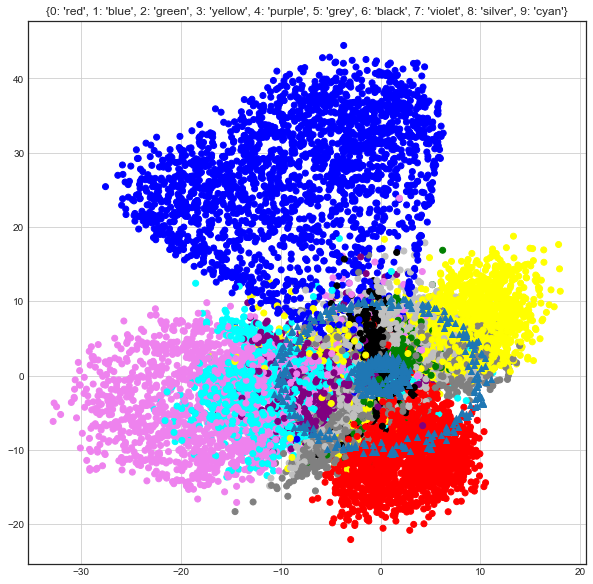

 iter: 320 batch: 19500 range: 1.1391293059145107e-19 recon cost: 0.18446293 zero cost: 0.56075954								 one  cost: 0.634395 fake cost: 1.131979342

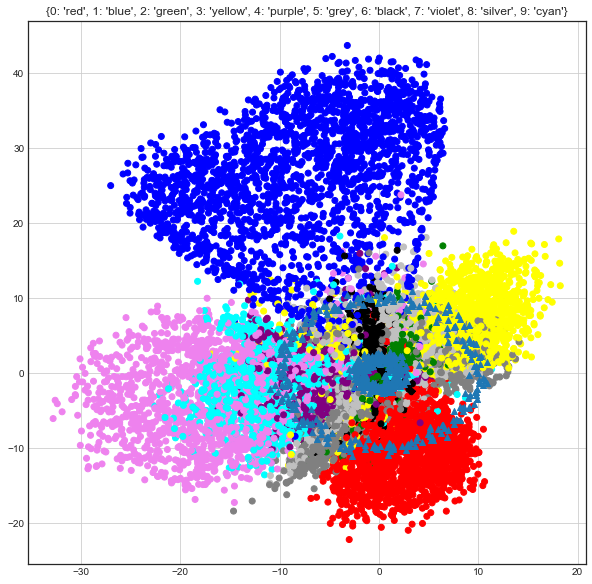

 iter: 330 batch: 19500 range: 3.971898294584674e-20 recon cost: 0.18604453 zero cost: 0.5715834								 one  cost: 0.6340779 fake cost: 1.1240965165

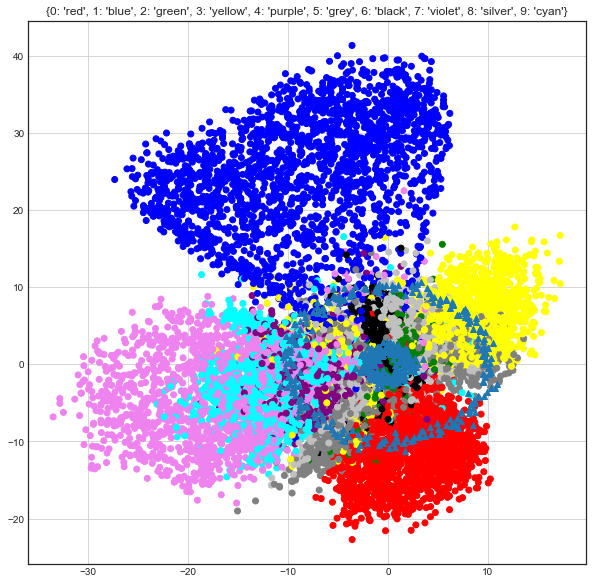

 iter: 340 batch: 19500 range: 1.3849153015916346e-20 recon cost: 0.18400969 zero cost: 0.5693159								 one  cost: 0.62351894 fake cost: 1.129393633

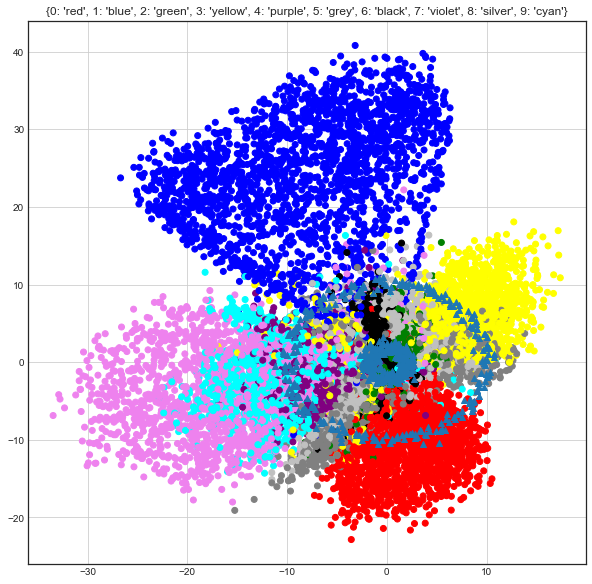

 iter: 350 batch: 19500 range: 4.828901070295922e-21 recon cost: 0.18323103 zero cost: 0.5717416								 one  cost: 0.61991495 fake cost: 1.128925914

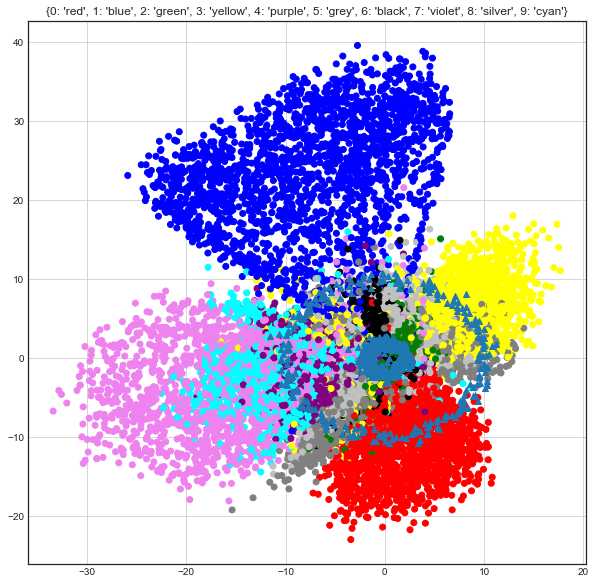

 iter: 360 batch: 19500 range: 1.683733692588003e-21 recon cost: 0.18309057 zero cost: 0.5800467								 one  cost: 0.6150935 fake cost: 1.1216927598

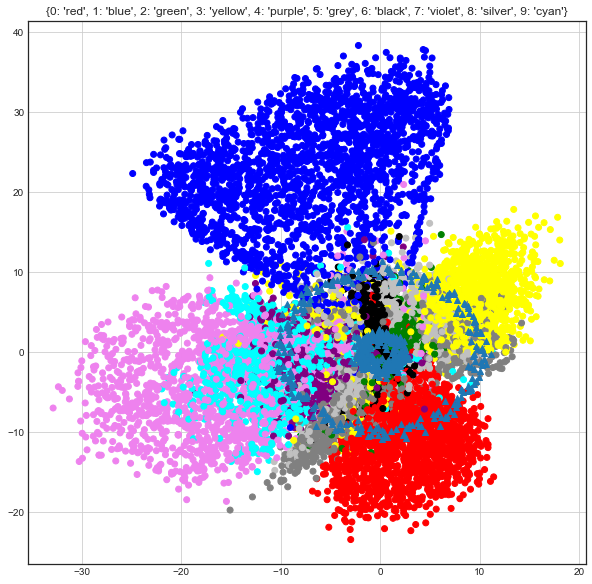

 iter: 370 batch: 19500 range: 5.870816374753979e-22 recon cost: 0.18257426 zero cost: 0.5750573								 one  cost: 0.61656326 fake cost: 1.131097848

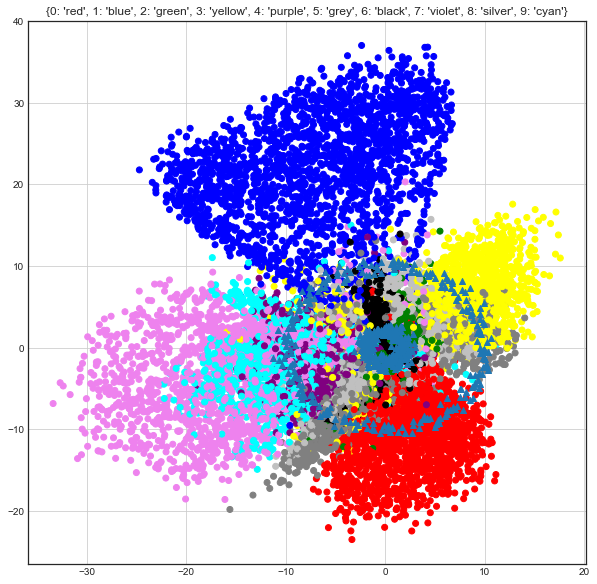

 iter: 380 batch: 19500 range: 2.047027095662755e-22 recon cost: 0.18260917 zero cost: 0.5792876								 one  cost: 0.6104078 fake cost: 1.1284816219

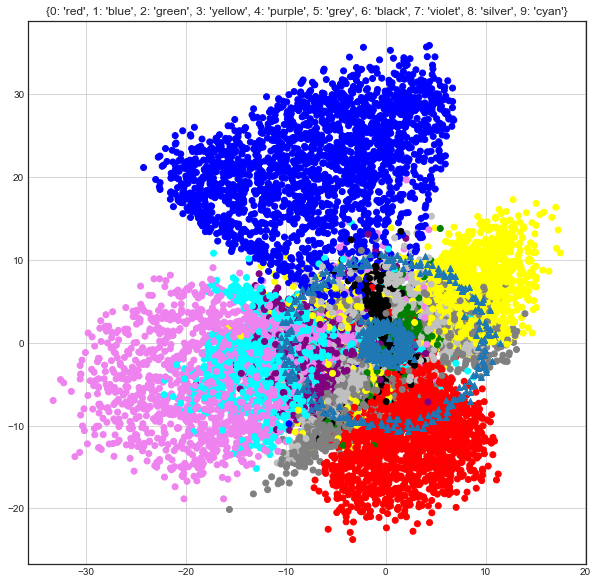

 iter: 390 batch: 19500 range: 7.137542145581231e-23 recon cost: 0.18255156 zero cost: 0.57997346								 one  cost: 0.6065775 fake cost: 1.129587457

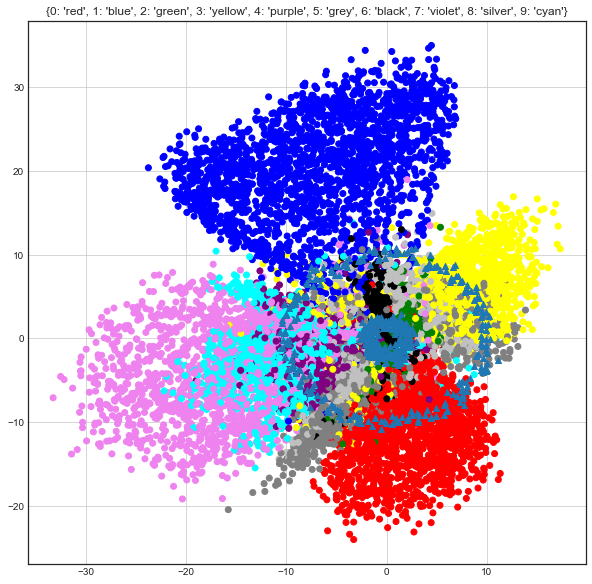

 iter: 400 batch: 19500 range: 2.488707061469271e-23 recon cost: 0.18320511 zero cost: 0.59206665								 one  cost: 0.6021902 fake cost: 1.118510618

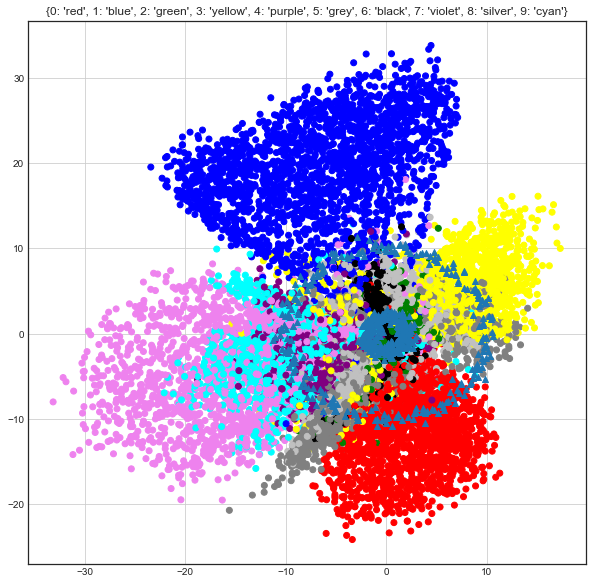

 iter: 410 batch: 19500 range: 8.677584960589601e-24 recon cost: 0.18148771 zero cost: 0.58560705								 one  cost: 0.59463763 fake cost: 1.139060454

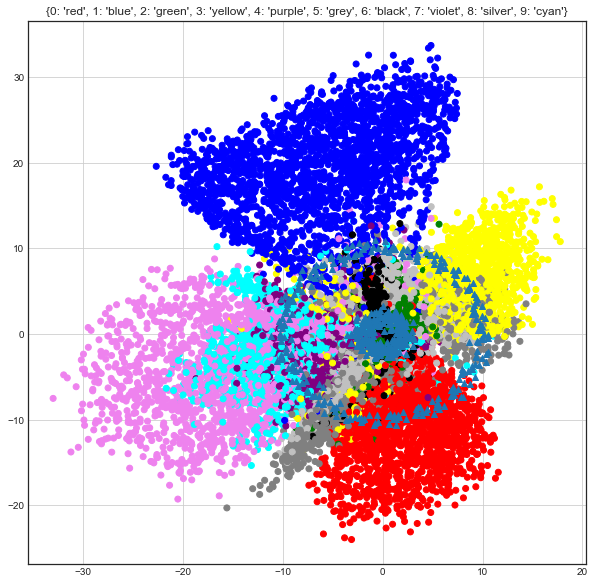

 iter: 420 batch: 19500 range: 3.0256867878936034e-24 recon cost: 0.18117979 zero cost: 0.58708555								 one  cost: 0.59139824 fake cost: 1.1233559

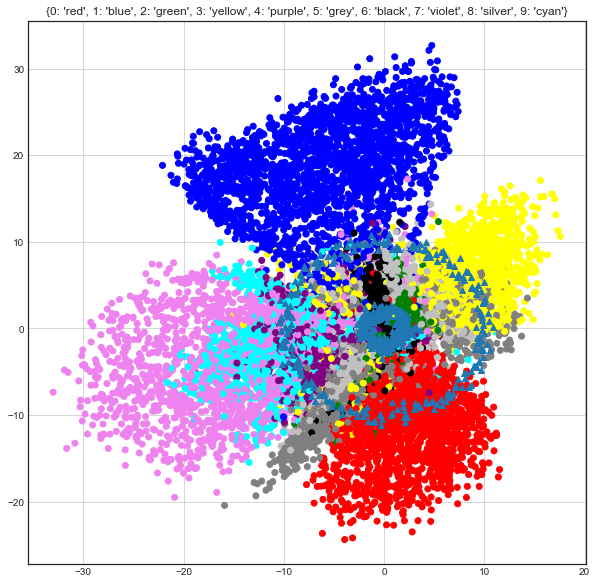

 iter: 430 batch: 19500 range: 1.0549917494339213e-24 recon cost: 0.18125108 zero cost: 0.58894426								 one  cost: 0.5830888 fake cost: 1.118899163

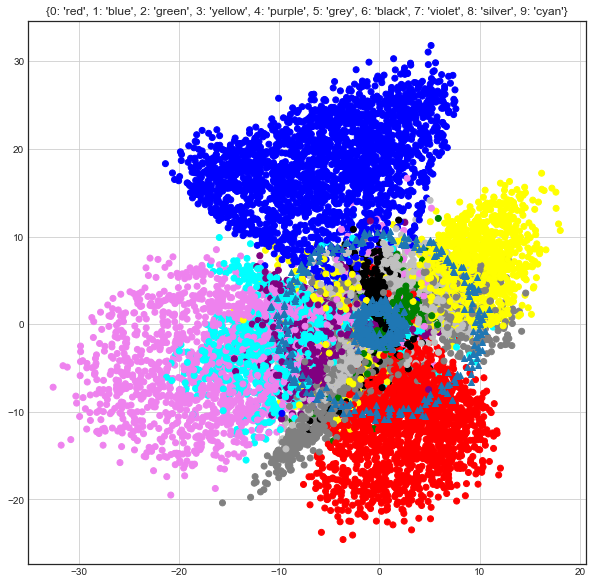

 iter: 440 batch: 19500 range: 3.6785287751098987e-25 recon cost: 0.18065137 zero cost: 0.5872838								 one  cost: 0.5842722 fake cost: 1.1254581815

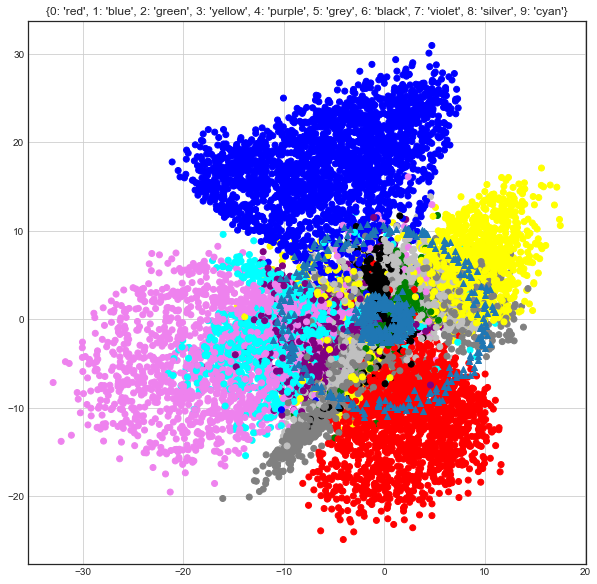

 iter: 450 batch: 19500 range: 1.2826236751682832e-25 recon cost: 0.18041486 zero cost: 0.58775556								 one  cost: 0.572342 fake cost: 1.119862445

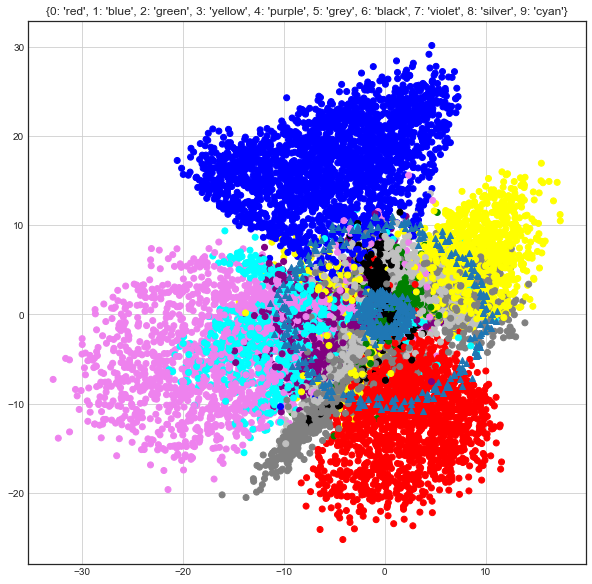

 iter: 460 batch: 19500 range: 4.472232222930062e-26 recon cost: 0.1803237 zero cost: 0.5909933								 one  cost: 0.56917727 fake cost: 1.11550977556

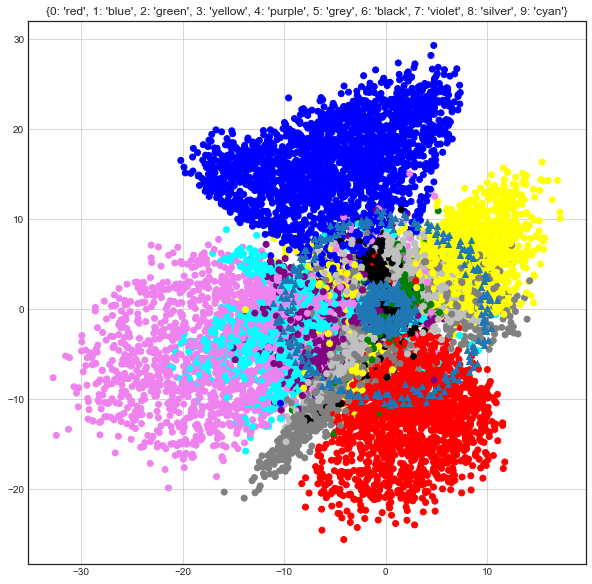

 iter: 470 batch: 19500 range: 1.5593709552562102e-26 recon cost: 0.18114585 zero cost: 0.5838804								 one  cost: 0.56200945 fake cost: 1.15272784

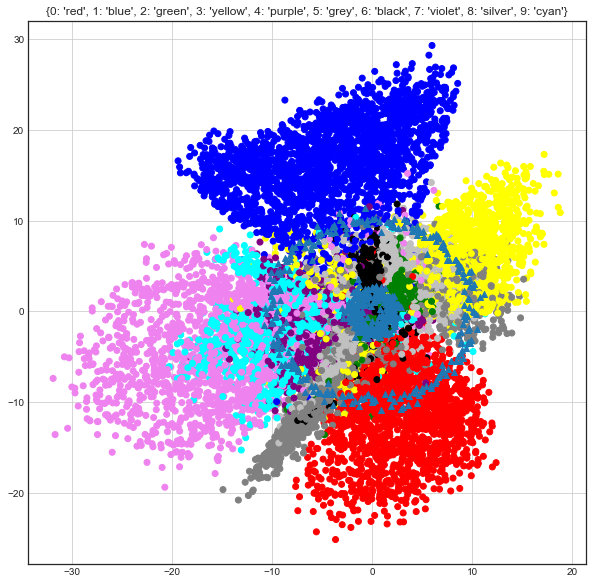

 iter: 480 batch: 19500 range: 5.4371903221598246e-27 recon cost: 0.17993371 zero cost: 0.58258593								 one  cost: 0.5547446 fake cost: 1.15152321

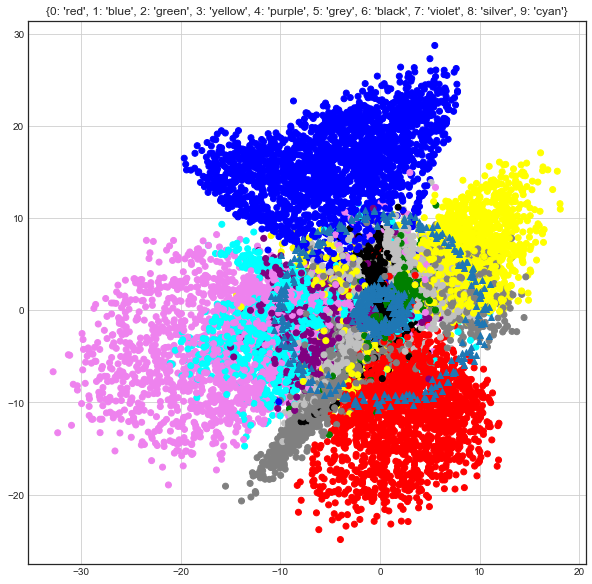

 iter: 490 batch: 19500 range: 1.895831040057505e-27 recon cost: 0.1796303 zero cost: 0.58120143								 one  cost: 0.5485535 fake cost: 1.1528337838

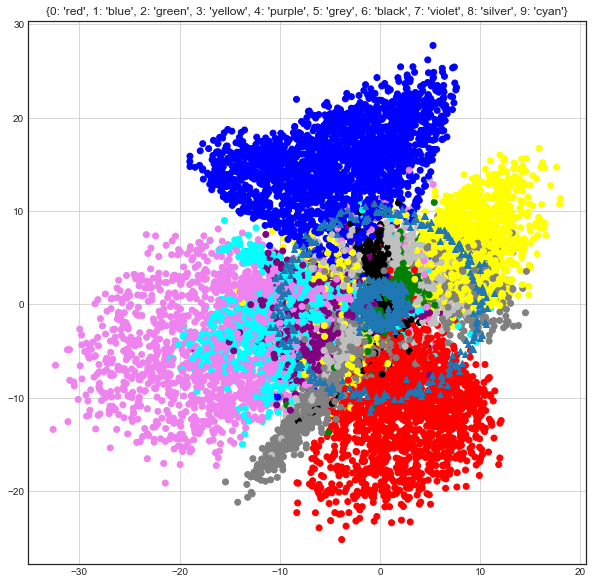

 iter: 500 batch: 19500 range: 6.610354097404116e-28 recon cost: 0.17936948 zero cost: 0.5823008								 one  cost: 0.548624 fake cost: 1.14307774556

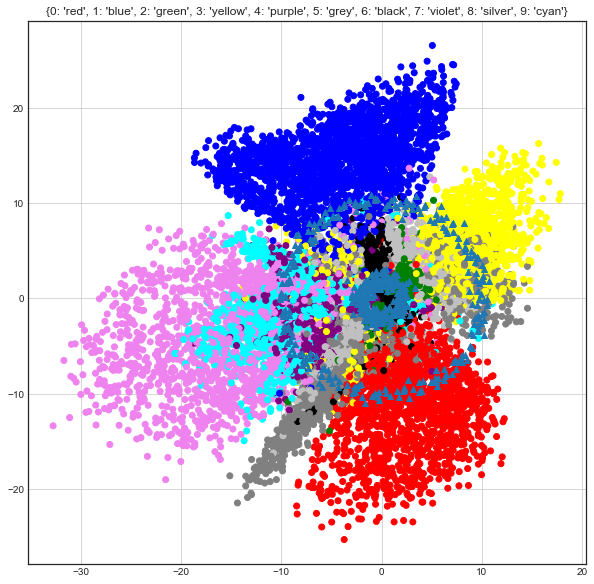

 iter: 510 batch: 19500 range: 2.3048879551915112e-28 recon cost: 0.17914508 zero cost: 0.5794646								 one  cost: 0.53418833 fake cost: 1.15582189

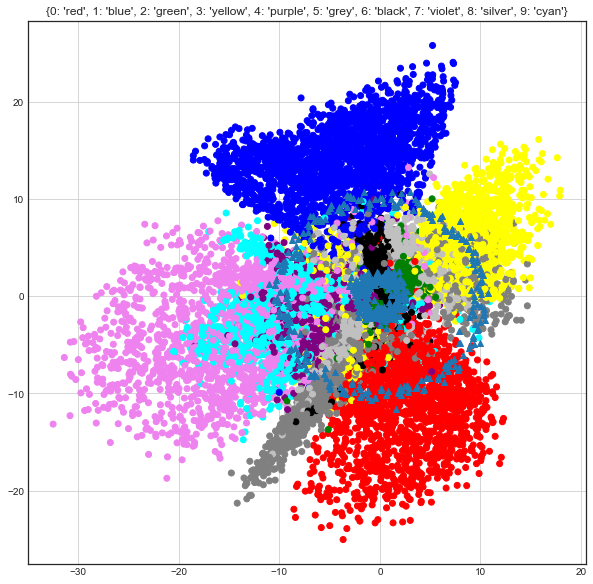

 iter: 520 batch: 19500 range: 8.036647368214552e-29 recon cost: 0.17907262 zero cost: 0.5776245								 one  cost: 0.52191895 fake cost: 1.1660755745

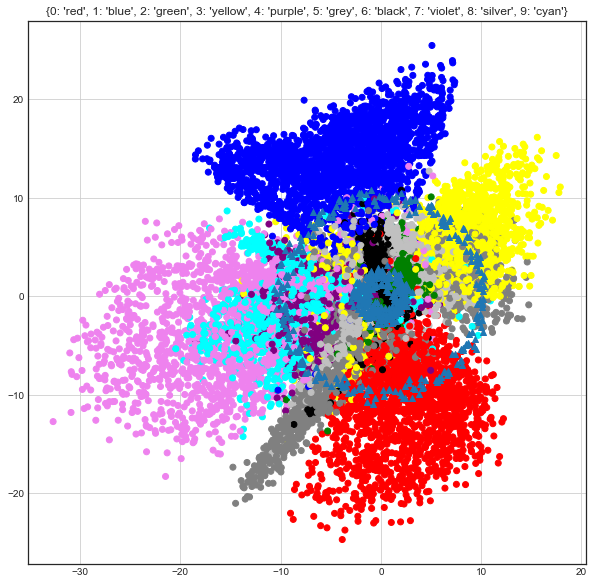

 iter: 530 batch: 19500 range: 2.80220566798282e-29 recon cost: 0.1787938 zero cost: 0.57270855								 one  cost: 0.51466537 fake cost: 1.1894779866

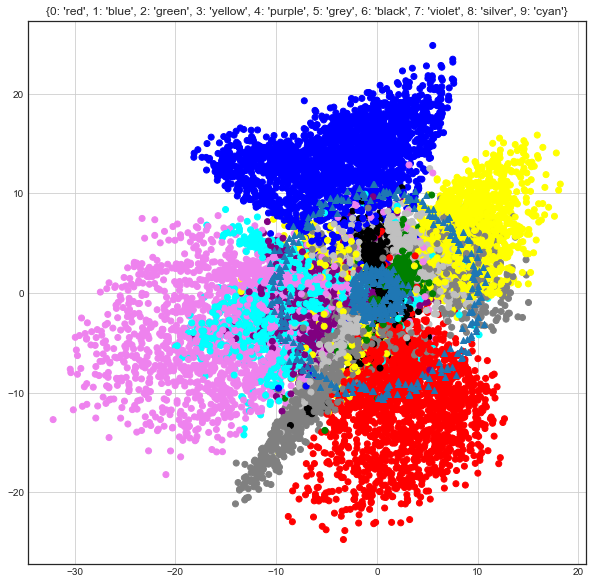

 iter: 540 batch: 19500 range: 9.770687011516283e-30 recon cost: 0.17884234 zero cost: 0.56206286								 one  cost: 0.5025577 fake cost: 1.230534347

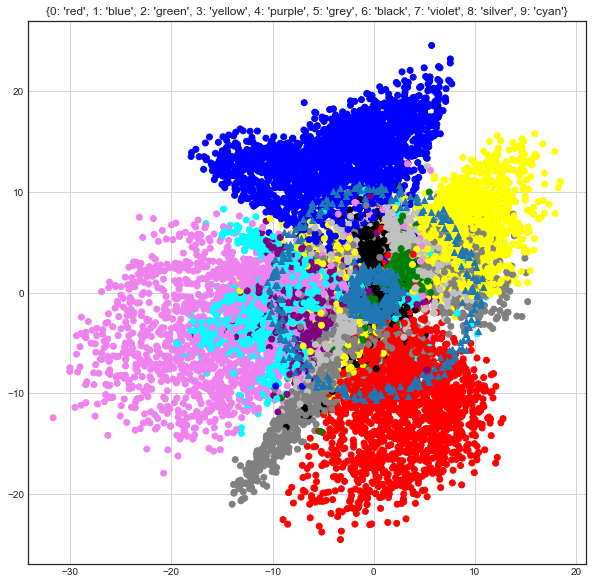

 iter: 550 batch: 19500 range: 3.4068279058808295e-30 recon cost: 0.17970031 zero cost: 0.56863654								 one  cost: 0.49736384 fake cost: 1.2131133

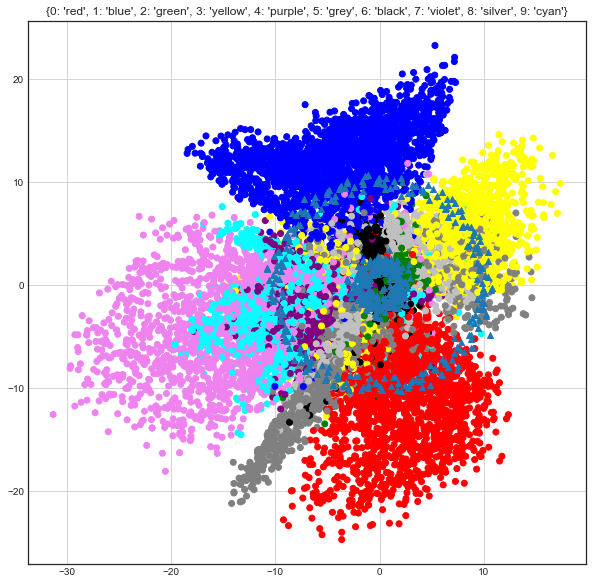

 iter: 560 batch: 19500 range: 1.1878874399116773e-30 recon cost: 0.17850809 zero cost: 0.55774045								 one  cost: 0.4873228 fake cost: 1.25595052

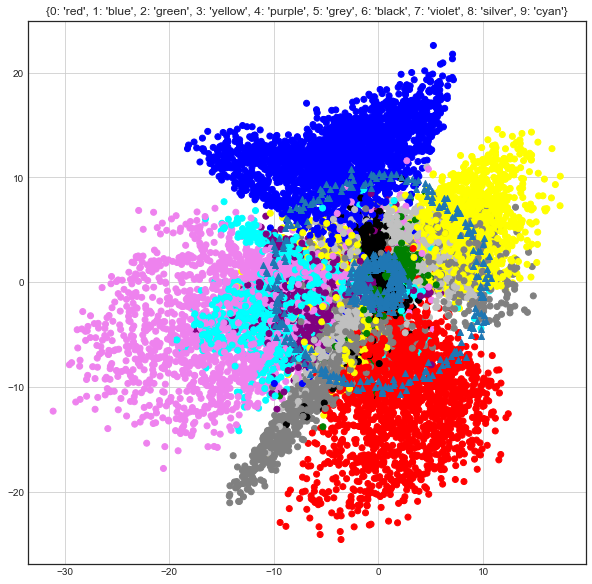

 iter: 570 batch: 19500 range: 4.141907395627863e-31 recon cost: 0.17873019 zero cost: 0.54956377								 one  cost: 0.48415628 fake cost: 1.29800937

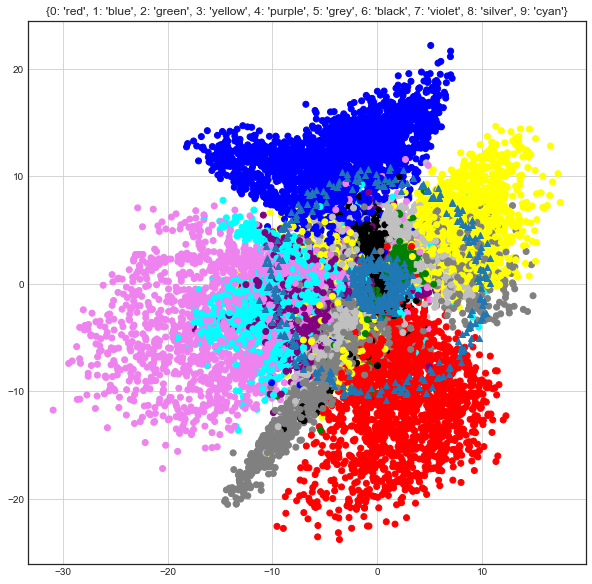

 iter: 580 batch: 19500 range: 1.444193809746177e-31 recon cost: 0.17797756 zero cost: 0.54634297								 one  cost: 0.4840449 fake cost: 1.313092382

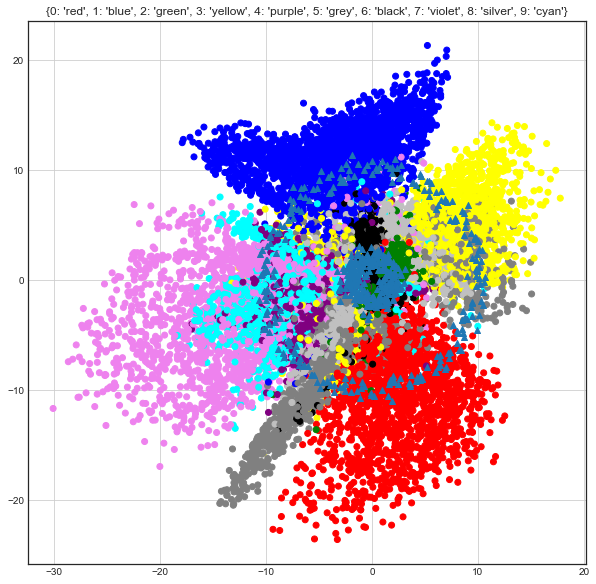

 iter: 590 batch: 19500 range: 5.035592447843733e-32 recon cost: 0.17841949 zero cost: 0.54830074								 one  cost: 0.4656043 fake cost: 1.331497418

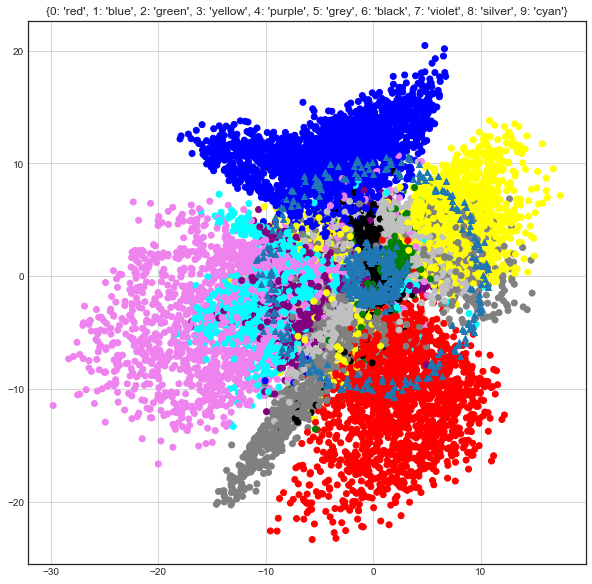

 iter: 600 batch: 19500 range: 1.755802519693494e-32 recon cost: 0.17838642 zero cost: 0.54074645								 one  cost: 0.4577591 fake cost: 1.379694345

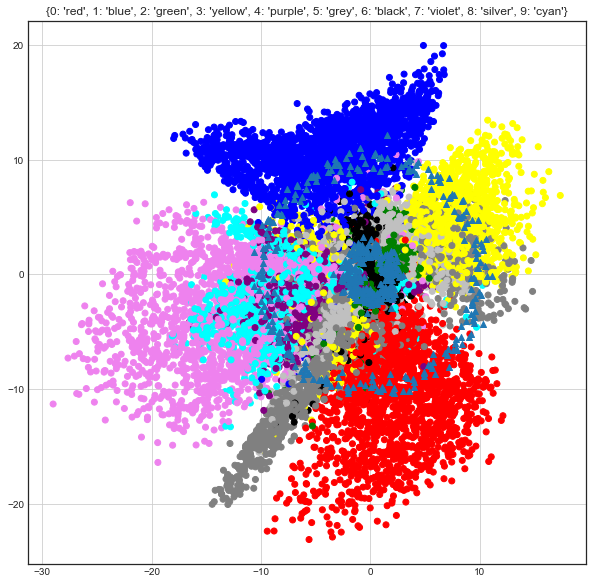

 iter: 610 batch: 19500 range: 6.122104836903772e-33 recon cost: 0.17733581 zero cost: 0.52080005								 one  cost: 0.449858 fake cost: 1.4425236862

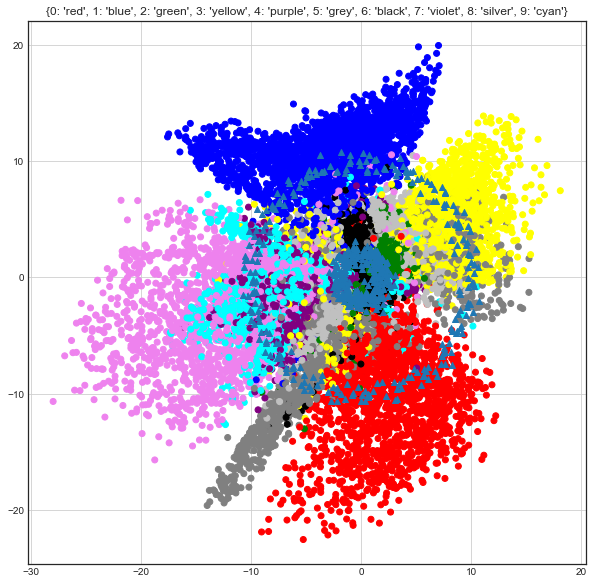

 iter: 620 batch: 19500 range: 2.1346459646602732e-33 recon cost: 0.17702843 zero cost: 0.5259076								 one  cost: 0.44532153 fake cost: 1.44157816

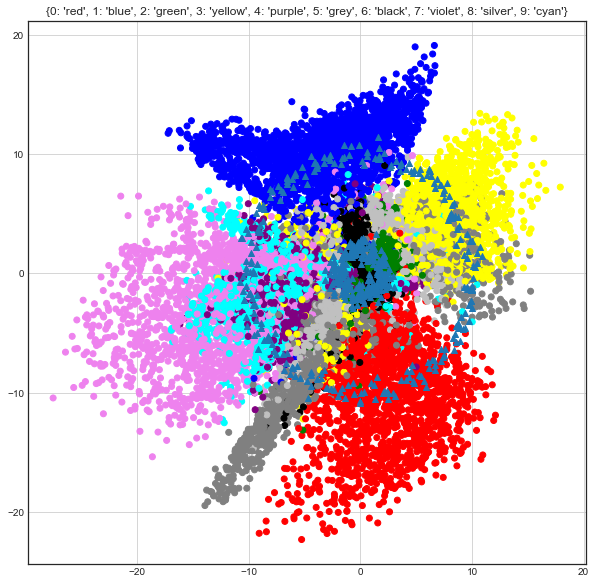

 iter: 630 batch: 19500 range: 7.44305025123504e-34 recon cost: 0.17705405 zero cost: 0.5168743								 one  cost: 0.44274396 fake cost: 1.4741875741

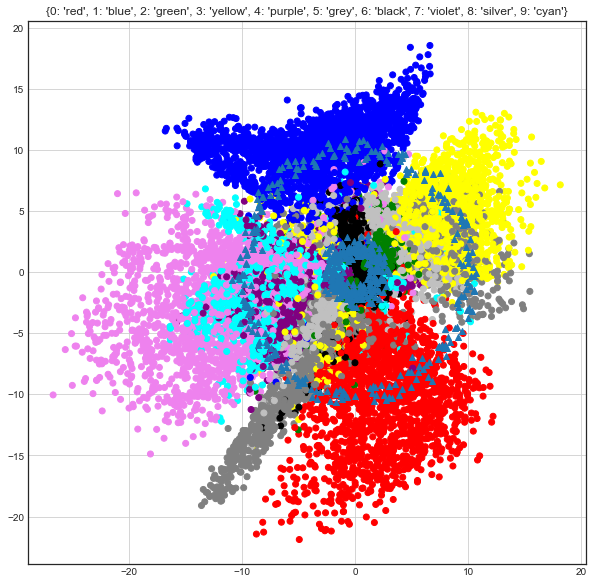

 iter: 640 batch: 19500 range: 2.5952311511865474e-34 recon cost: 0.176912 zero cost: 0.5232827								 one  cost: 0.4295765 fake cost: 1.50242332777

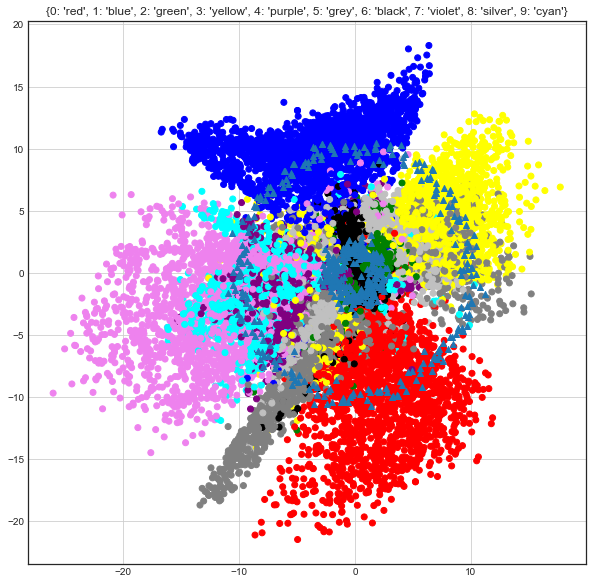

 iter: 650 batch: 19500 range: 9.049011494946527e-35 recon cost: 0.17704082 zero cost: 0.52508986								 one  cost: 0.43958628 fake cost: 1.53554468

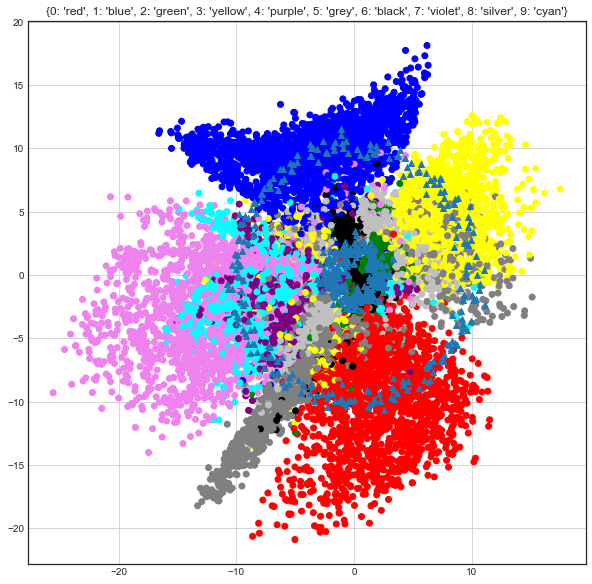

 iter: 660 batch: 19500 range: 3.155195212504924e-35 recon cost: 0.17641297 zero cost: 0.5037236								 one  cost: 0.43795812 fake cost: 1.589170555

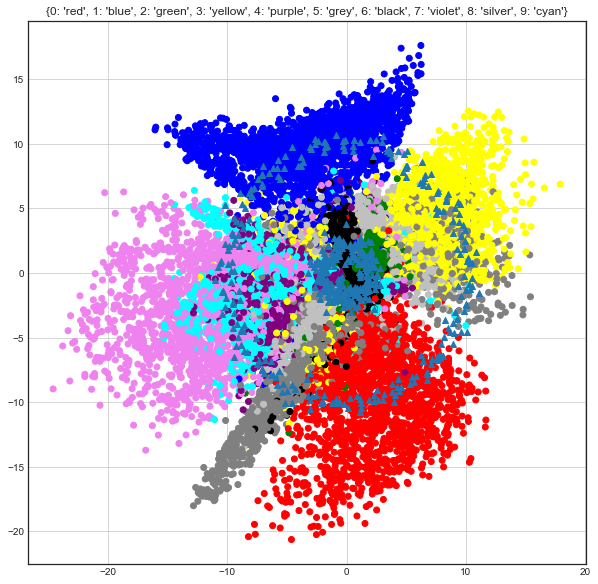

 iter: 670 batch: 19500 range: 1.1001485449072052e-35 recon cost: 0.17719324 zero cost: 0.48804864								 one  cost: 0.43004736 fake cost: 1.6457343

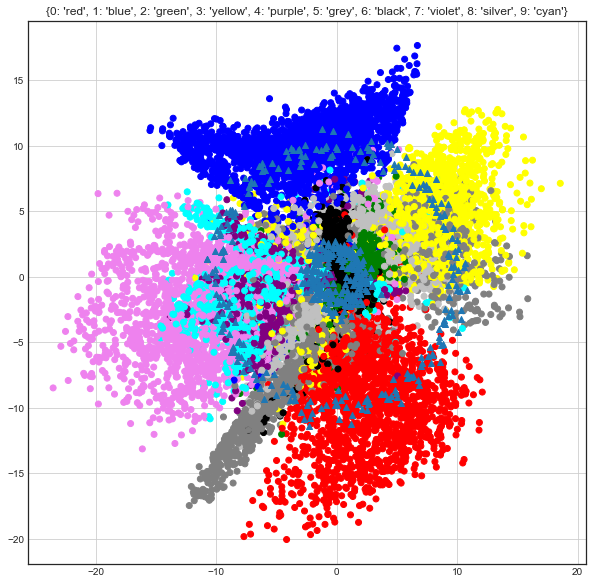

 iter: 680 batch: 19500 range: 3.835980785165292e-36 recon cost: 0.17618093 zero cost: 0.49314582								 one  cost: 0.41730604 fake cost: 1.6626916

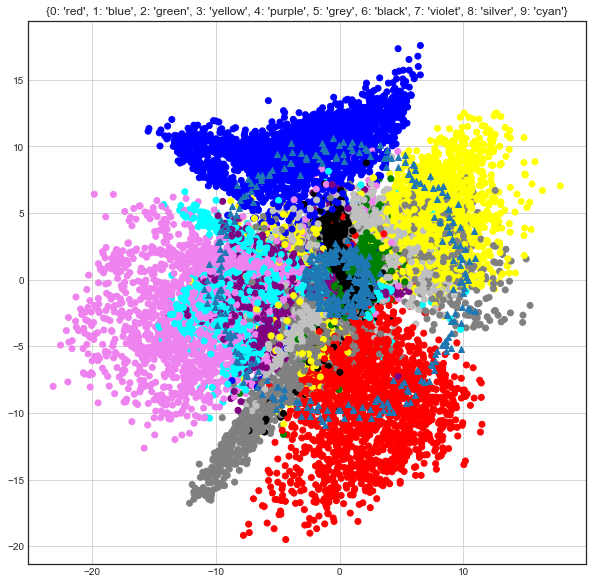

 iter: 690 batch: 19500 range: 1.3375237964250077e-36 recon cost: 0.1758376 zero cost: 0.4816216								 one  cost: 0.42676565 fake cost: 1.715223839

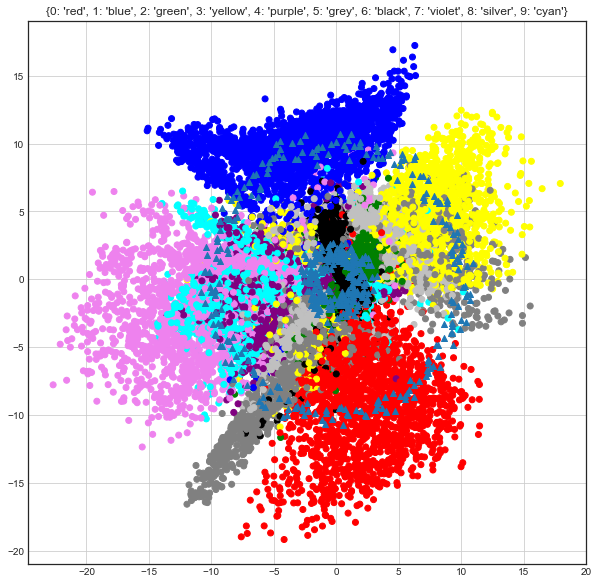

 iter: 700 batch: 19500 range: 4.663657109341017e-37 recon cost: 0.17754468 zero cost: 0.5103339								 one  cost: 0.4152173 fake cost: 1.7073998572

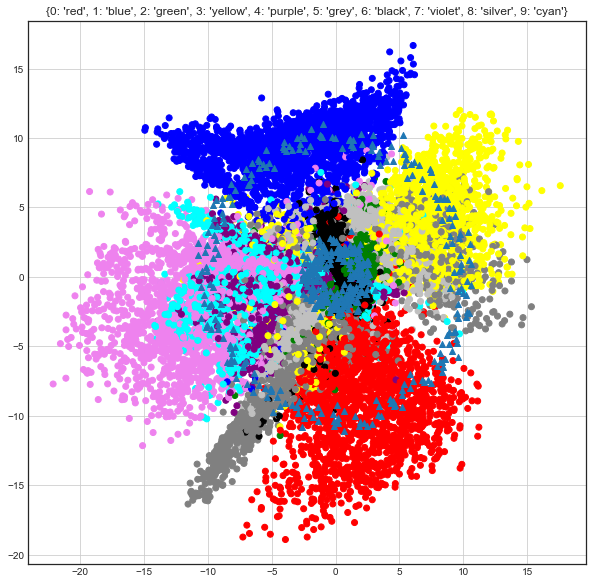

 iter: 710 batch: 19500 range: 1.6261166860463014e-37 recon cost: 0.1765837 zero cost: 0.45347202								 one  cost: 0.4257324 fake cost: 1.805699519

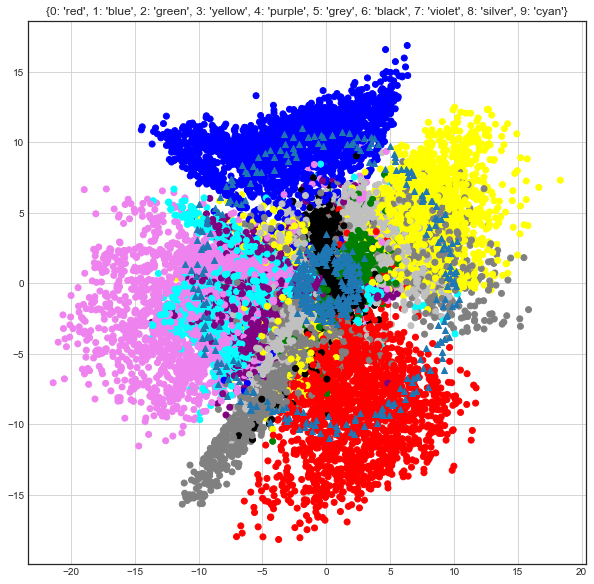

 iter: 720 batch: 19500 range: 5.669918295112059e-38 recon cost: 0.17541187 zero cost: 0.46089286								 one  cost: 0.41593823 fake cost: 1.81620661

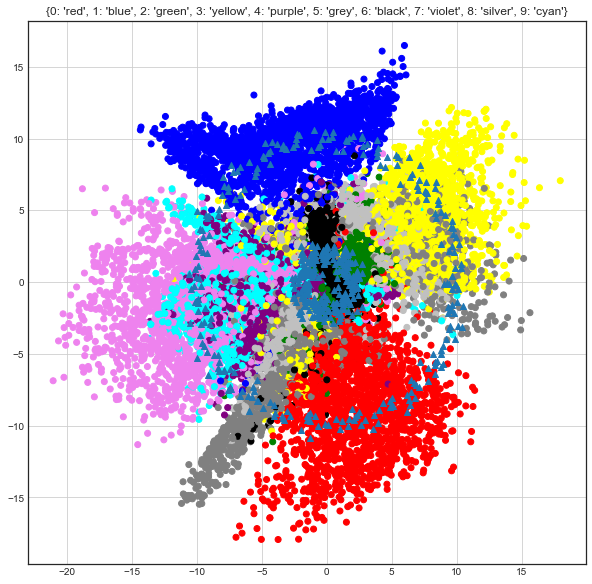

 iter: 730 batch: 19500 range: 1.976978266634125e-38 recon cost: 0.17989597 zero cost: 0.5165072								 one  cost: 0.42458993 fake cost: 1.807244997

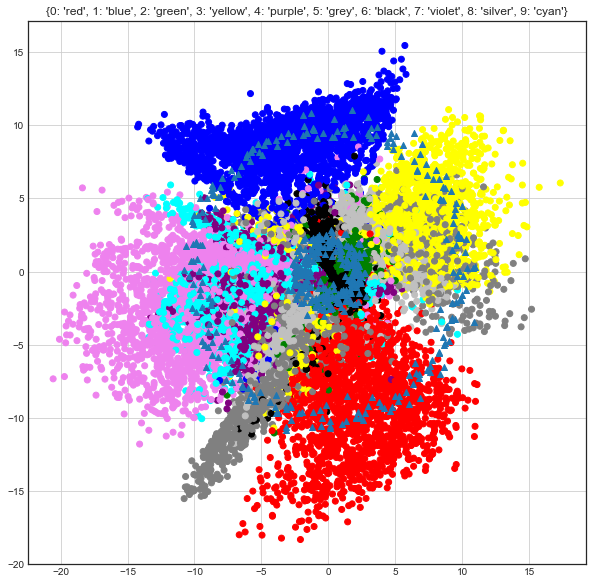

 iter: 740 batch: 19500 range: 6.893296981215887e-39 recon cost: 0.17554025 zero cost: 0.47612715								 one  cost: 0.4241741 fake cost: 1.857166363

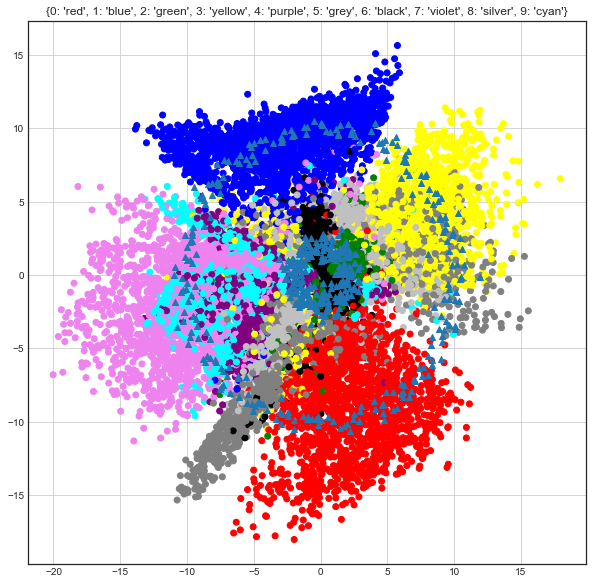

 iter: 750 batch: 19500 range: 2.4035440385563948e-39 recon cost: 0.17510244 zero cost: 0.46798298								 one  cost: 0.42181832 fake cost: 1.9020525

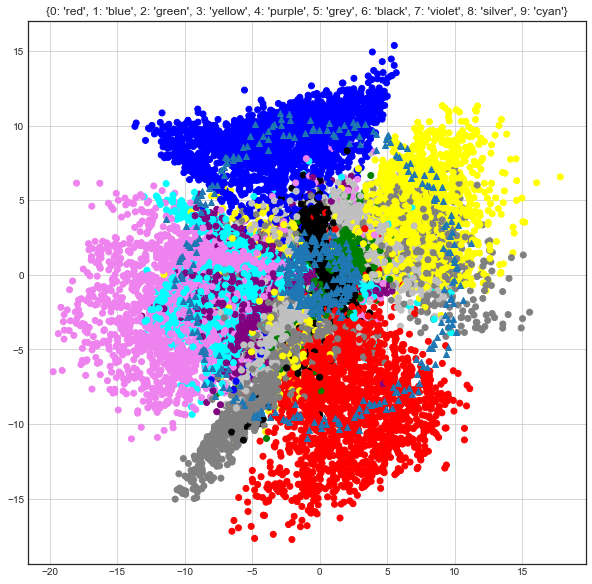

 iter: 760 batch: 19500 range: 8.380639860754983e-40 recon cost: 0.17490646 zero cost: 0.4557552								 one  cost: 0.42880243 fake cost: 1.933617497

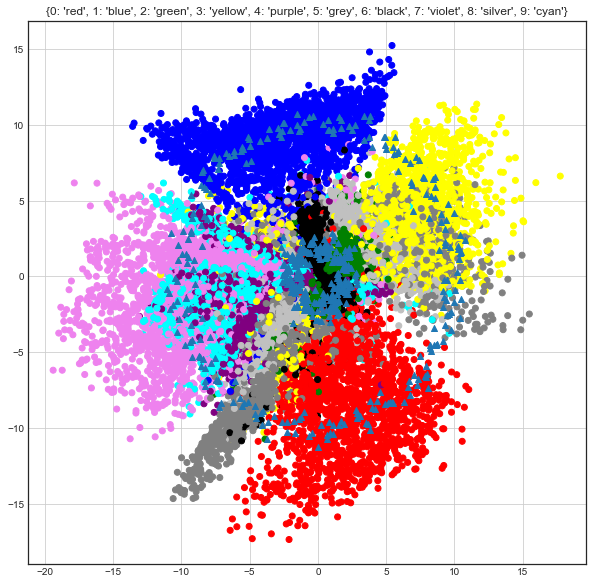

 iter: 770 batch: 19500 range: 2.9221484336879297e-40 recon cost: 0.17589377 zero cost: 0.47870758								 one  cost: 0.4236965 fake cost: 1.95359419

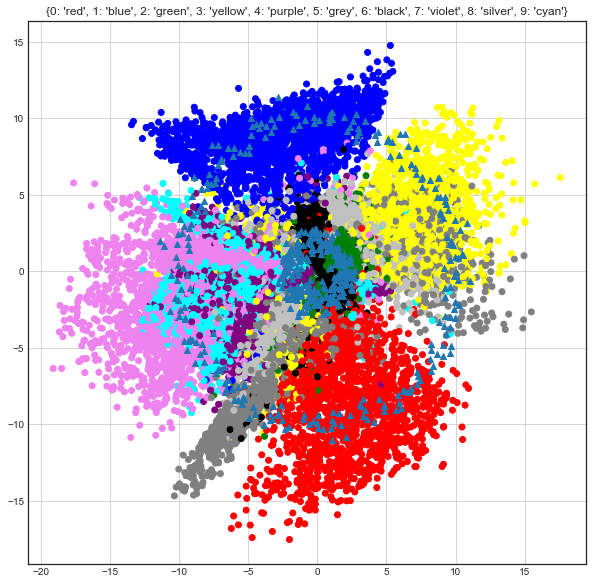

 iter: 780 batch: 19500 range: 1.0188901575989658e-40 recon cost: 0.17504668 zero cost: 0.47215194								 one  cost: 0.417547 fake cost: 1.960232955

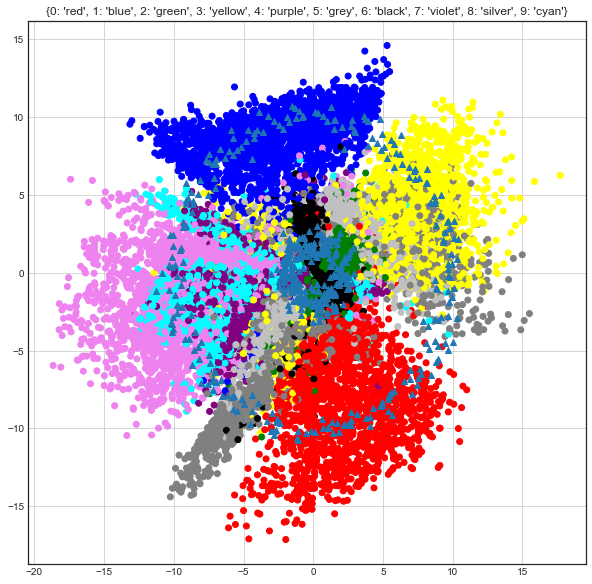

 iter: 790 batch: 19500 range: 3.5526503078485063e-41 recon cost: 0.17494212 zero cost: 0.4596633								 one  cost: 0.43022236 fake cost: 1.99747375

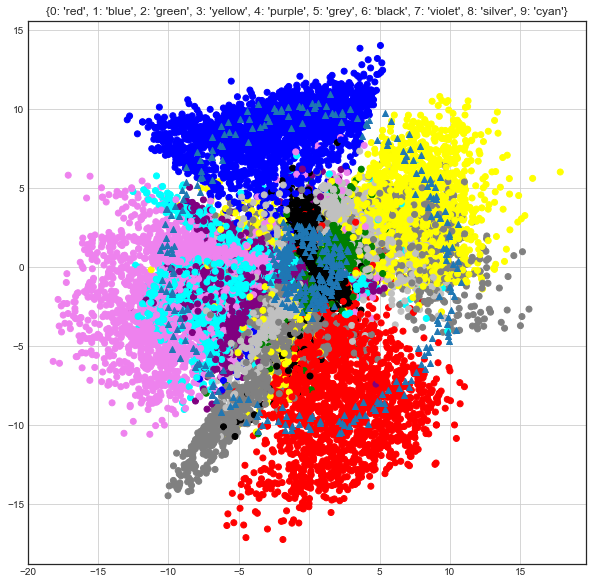

 iter: 800 batch: 19500 range: 1.2387325675614022e-41 recon cost: 0.17488673 zero cost: 0.43016252								 one  cost: 0.42303774 fake cost: 2.0675402

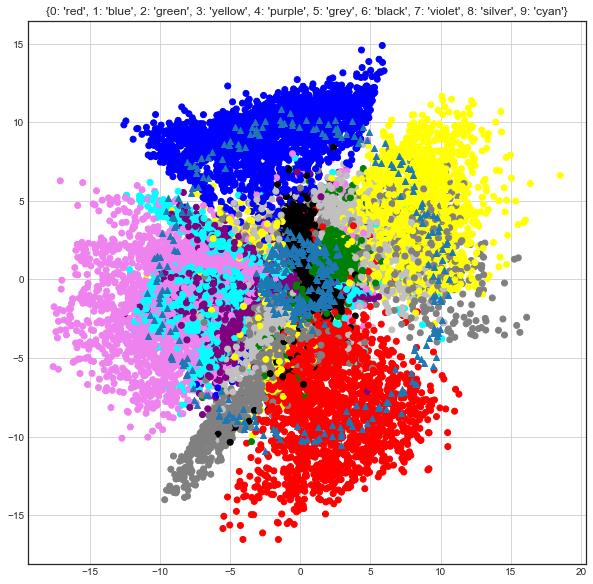

 iter: 810 batch: 19500 range: 4.3191933935837774e-42 recon cost: 0.17413338 zero cost: 0.43882117								 one  cost: 0.41962788 fake cost: 2.0759784

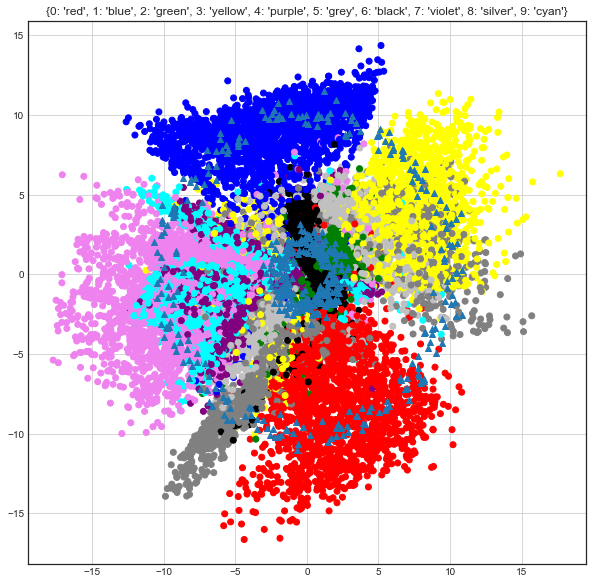

 iter: 820 batch: 19500 range: 1.506009614965017e-42 recon cost: 0.17402178 zero cost: 0.44426373								 one  cost: 0.42922804 fake cost: 2.07451344

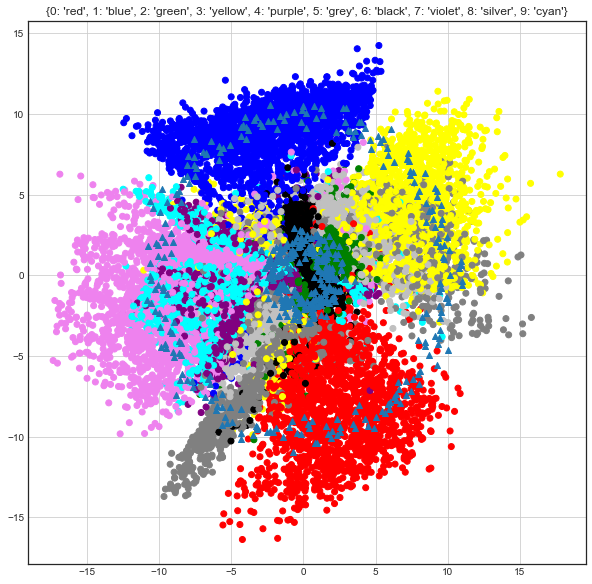

 iter: 830 batch: 19500 range: 5.251130833216038e-43 recon cost: 0.17411329 zero cost: 0.434919								 one  cost: 0.42754585 fake cost: 2.1129372628

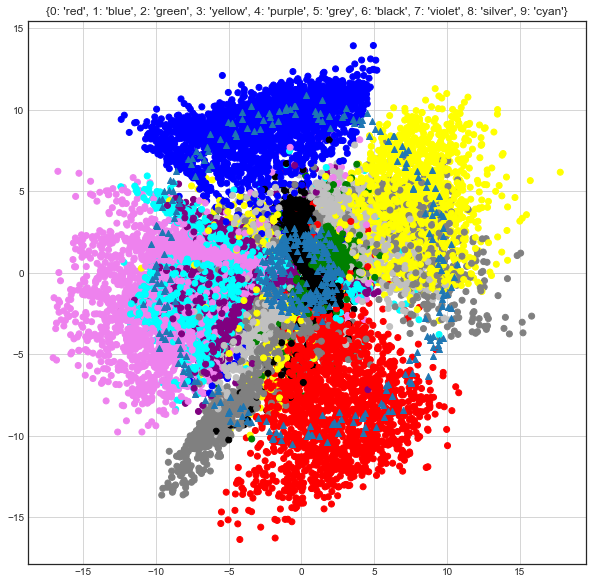

 iter: 840 batch: 19500 range: 1.830956107686782e-43 recon cost: 0.17391606 zero cost: 0.43713146								 one  cost: 0.4035342 fake cost: 2.118203429

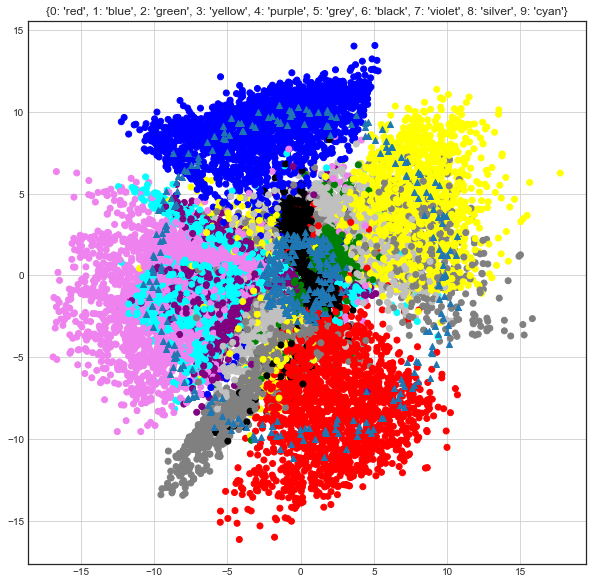

 iter: 850 batch: 19500 range: 6.38414919519795e-44 recon cost: 0.17432633 zero cost: 0.4235002								 one  cost: 0.42598146 fake cost: 2.1586924681

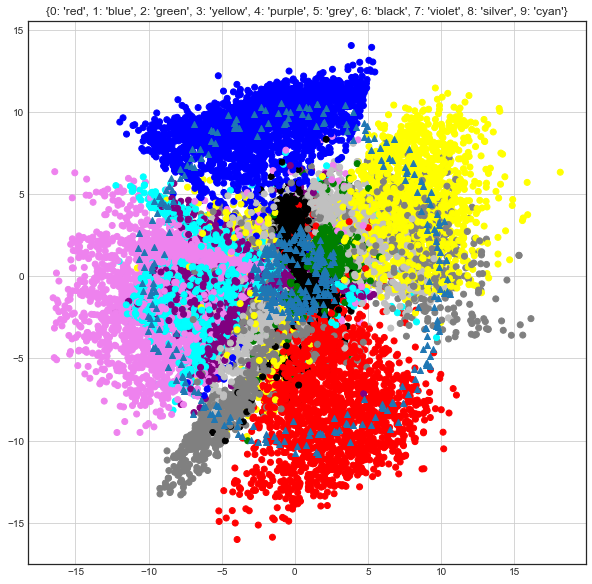

 iter: 860 batch: 19500 range: 2.226015182747292e-44 recon cost: 0.17556469 zero cost: 0.46562043								 one  cost: 0.44963384 fake cost: 2.15954734

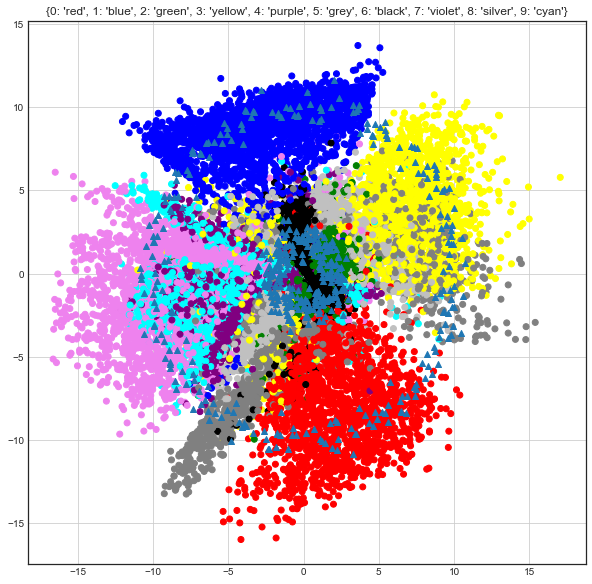

 iter: 870 batch: 19500 range: 7.761635015592424e-45 recon cost: 0.1735507 zero cost: 0.4465574								 one  cost: 0.40897936 fake cost: 2.1605818365

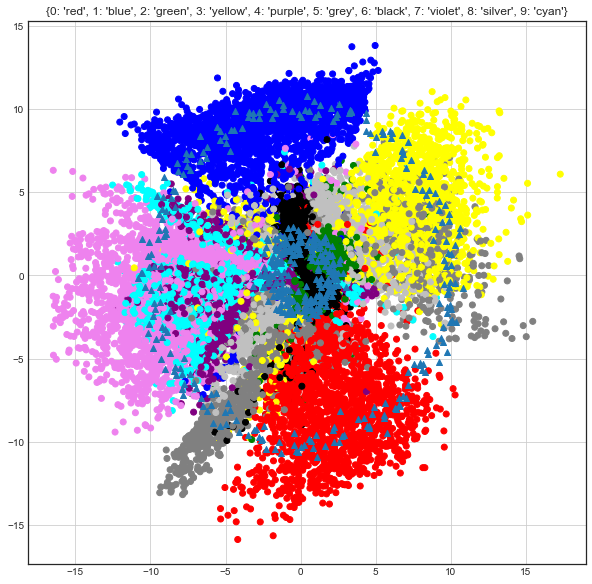

 iter: 880 batch: 19500 range: 2.7063147898623065e-45 recon cost: 0.17357218 zero cost: 0.44902524								 one  cost: 0.42133382 fake cost: 2.1553316

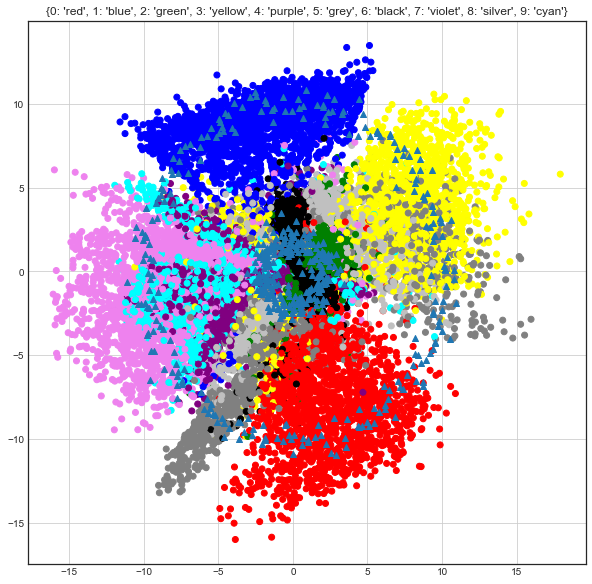

 iter: 890 batch: 19500 range: 9.436336193487484e-46 recon cost: 0.17325358 zero cost: 0.4479345								 one  cost: 0.4455298 fake cost: 2.1876397256

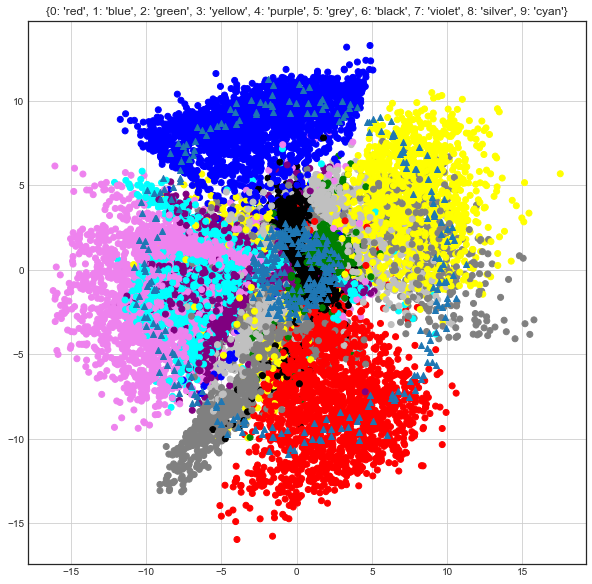

 iter: 900 batch: 19500 range: 3.290246984204388e-46 recon cost: 0.17310284 zero cost: 0.4453342								 one  cost: 0.41359407 fake cost: 2.190803338

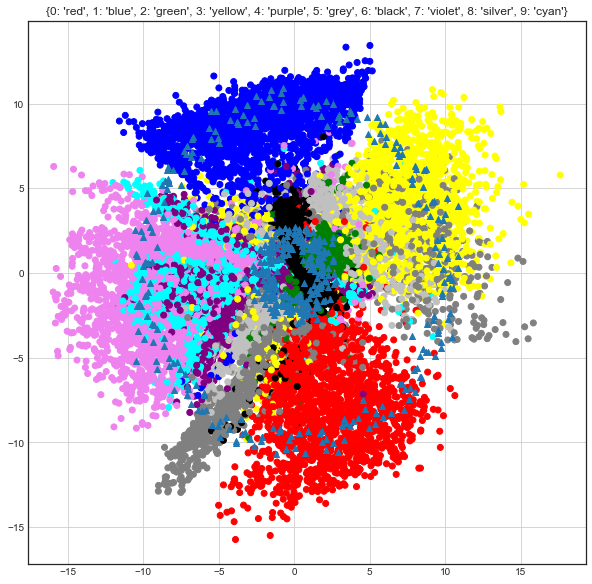

 iter: 910 batch: 19500 range: 1.1472381859961156e-46 recon cost: 0.17296731 zero cost: 0.44159755								 one  cost: 0.41674978 fake cost: 2.2093277

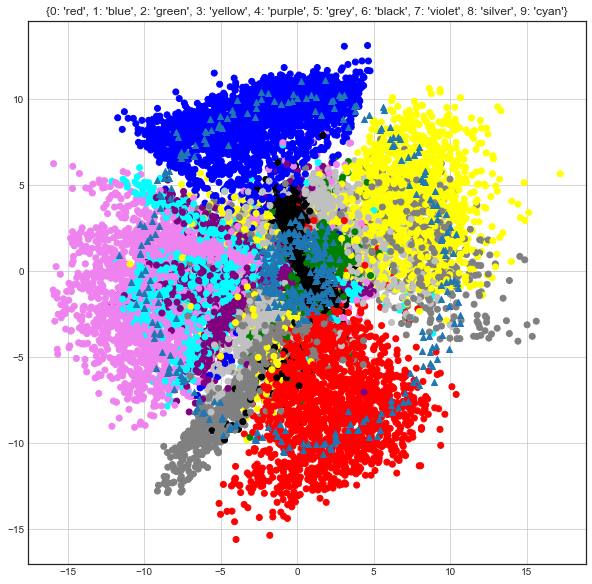

 iter: 920 batch: 19500 range: 4.000172211162794e-47 recon cost: 0.17514363 zero cost: 0.42074877								 one  cost: 0.4234924 fake cost: 2.283992511

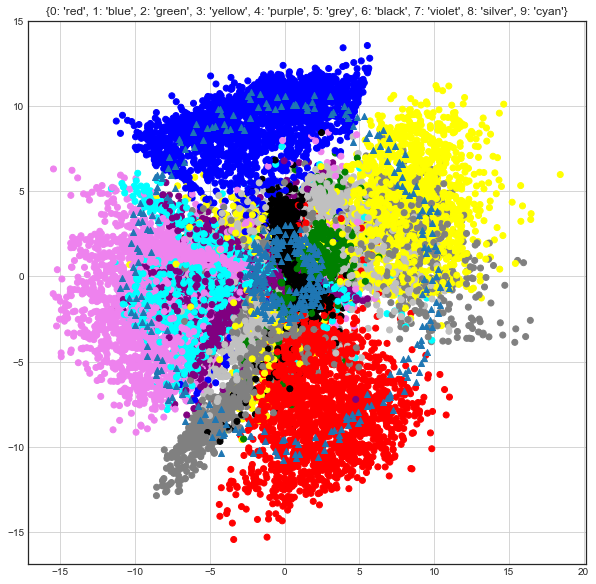

 iter: 930 batch: 19500 range: 1.3947738067196112e-47 recon cost: 0.17277583 zero cost: 0.4301346								 one  cost: 0.41911766 fake cost: 2.26252223

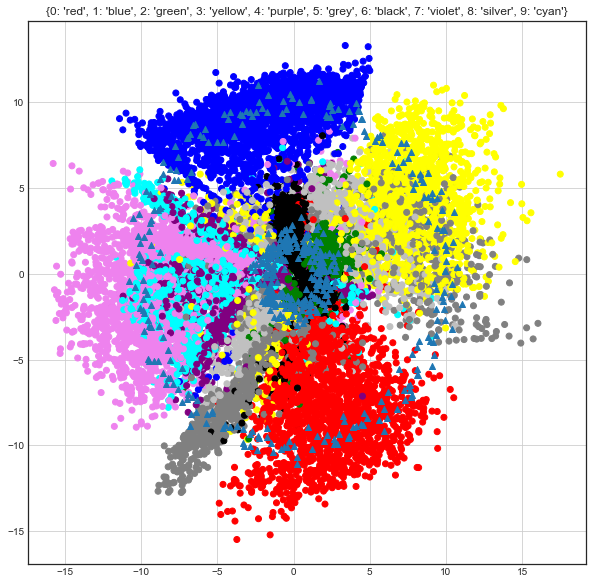

 iter: 940 batch: 19500 range: 4.863275552193331e-48 recon cost: 0.17356105 zero cost: 0.42521876								 one  cost: 0.4158516 fake cost: 2.273999743

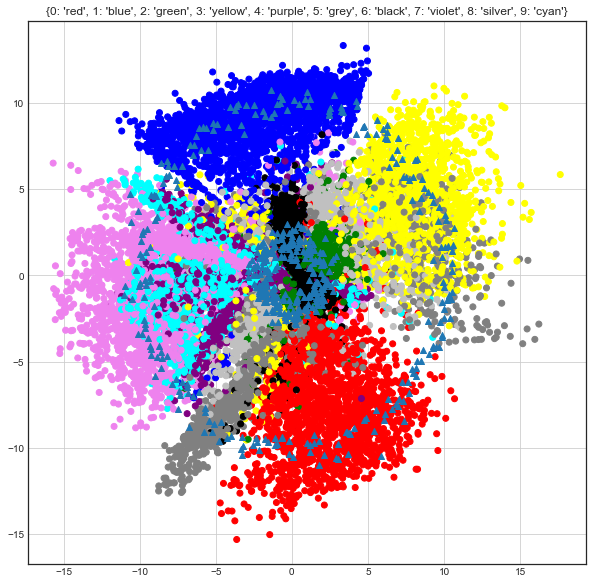

 iter: 950 batch: 19500 range: 1.6957193333152366e-48 recon cost: 0.17268363 zero cost: 0.44837204								 one  cost: 0.43297455 fake cost: 2.2617621

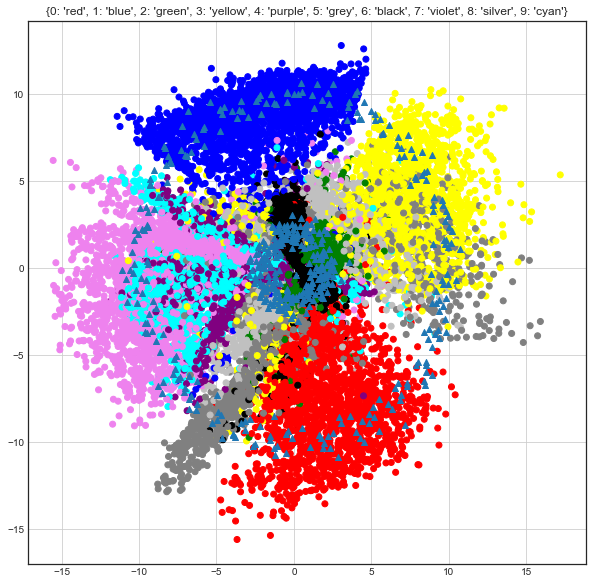

 iter: 960 batch: 19500 range: 5.912607719877687e-49 recon cost: 0.17256214 zero cost: 0.4396786								 one  cost: 0.42970547 fake cost: 2.265380649

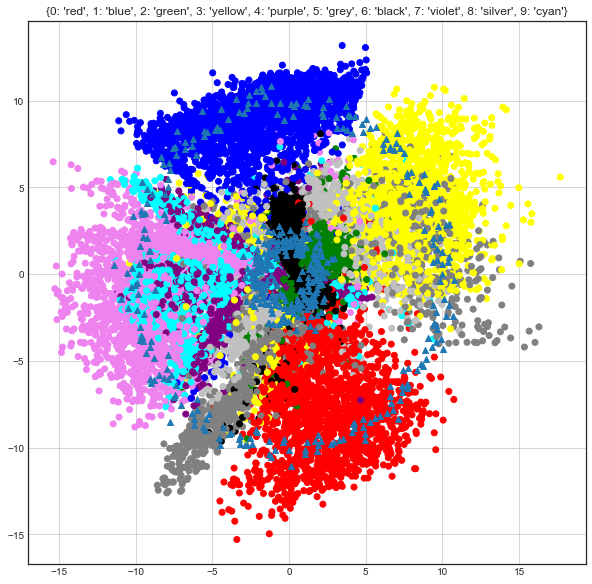

 iter: 970 batch: 19500 range: 2.0615988366901702e-49 recon cost: 0.17326137 zero cost: 0.44721273								 one  cost: 0.4370035 fake cost: 2.28668268

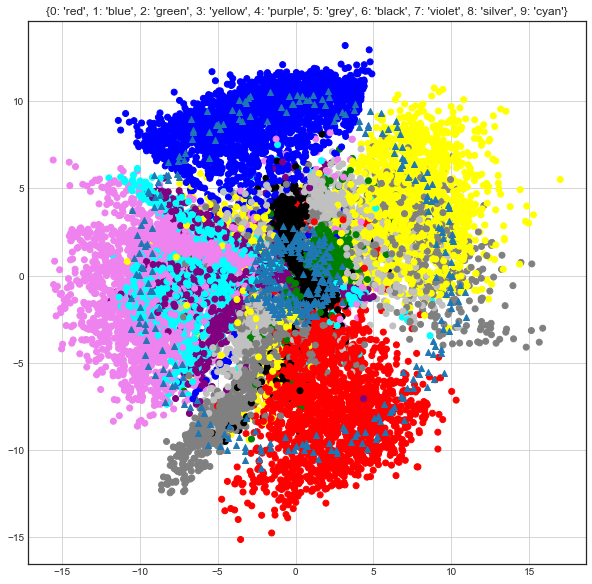

 iter: 980 batch: 19500 range: 7.1883506648910335e-50 recon cost: 0.17222619 zero cost: 0.45182428								 one  cost: 0.4457008 fake cost: 2.28916053

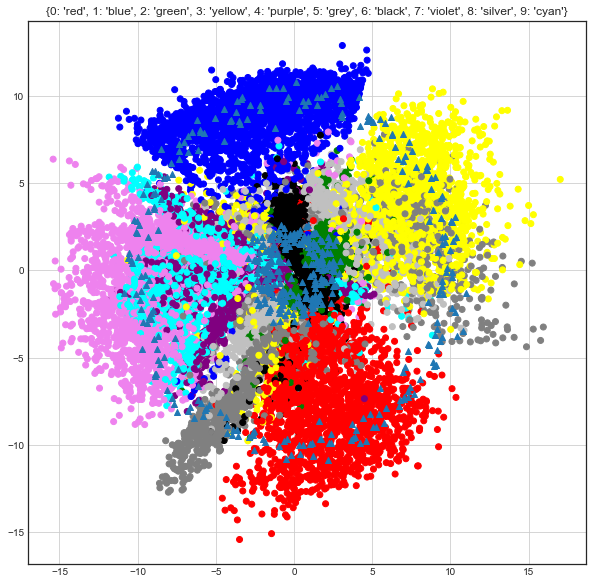

 iter: 990 batch: 19500 range: 2.5064228967260043e-50 recon cost: 0.17206736 zero cost: 0.44782048								 one  cost: 0.4126596 fake cost: 2.29571385

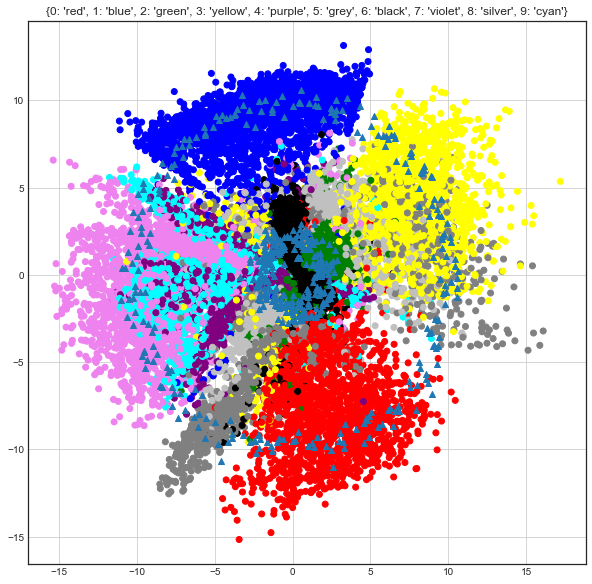

 iter: 1000 batch: 19500 range: 8.739356258613468e-51 recon cost: 0.17330873 zero cost: 0.45548975								 one  cost: 0.441888 fake cost: 2.320080866

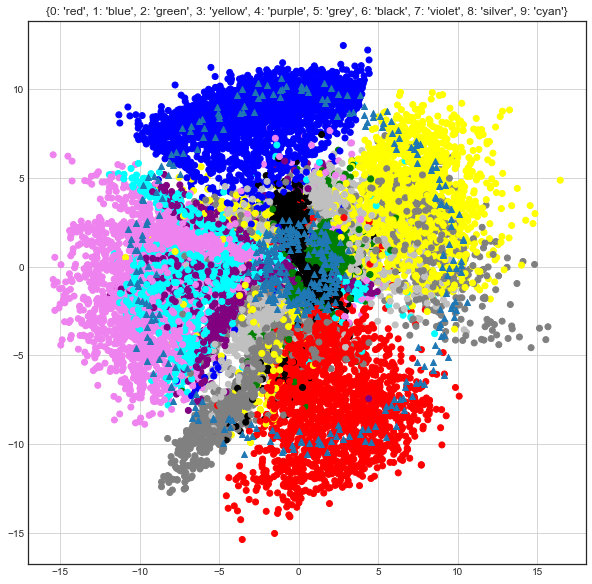

In [47]:
# start the session noise=.05
try:
    sess.run(tf.global_variables_initializer())
except:
    sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())
train_batch_shuffled = train_batch.copy()
color_dict = {0:'red',1:'blue',2:'green',3:'yellow',4:'purple',5:'grey',6:'black',7:'violet',8:'silver',9:'cyan'}
from sklearn import manifold, datasets

#                     00005
aimed_range_start = 0.00005
for iter in range(num_epoch):
    for current_data_index in range(0,len(train_batch),batch_size):
        prior_z,_    =  datasets.make_circles(n_samples=batch_size, factor=.2,noise=.05)
        prior_z = prior_z * 10
        current_data = train_batch_shuffled[current_data_index:current_data_index+batch_size].astype(np.float32)
    
        sess_result0 = sess.run([recon_cost,grad0_update],
        feed_dict={x0:current_data.reshape((batch_size,-1)),lr0:0.00008,aimed_range:aimed_range_start
        })

        sess_result1 = sess.run([dis_cost1,grad1_update],
        feed_dict={x1:current_data.reshape((batch_size,-1)),lr1:0.0001})

        sess_result2 = sess.run([dis_cost2,grad2_update],
        feed_dict={x2:prior_z                              ,lr2:0.0001})
        
        sess_result3 = sess.run([fake_cost,fake_grad_update],
        feed_dict={x3:current_data.reshape((batch_size,-1)),lr3:0.00008,aimed_range:aimed_range_start
                  })

        sys.stdout.write('\r iter: ' + str(iter) + ' batch: ' + str(current_data_index) + ' range: ' + str(aimed_range_start) + \
            ' recon cost: ' + str(sess_result0[0]) + \
            ' zero cost: ' + str(sess_result1[0]) + '\t\t\t\t\t\t\t\t' + \
            ' one  cost: ' + str(sess_result2[0]) + \
            ' fake cost: ' + str(sess_result3[0]) 
        ); sys.stdout.flush()
        
    aimed_range_start = aimed_range_start * 0.9    
    if iter % print_size == 0:
        random_idx = np.random.permutation(len(train_batch_shuffled))
        temp_data  = train_batch_shuffled[random_idx][:batch_size].reshape((batch_size,-1))
#         sess_result = sess.run(dlayer3,
#                       feed_dict={x0:temp_data }).reshape((batch_size,28,28))
#         fig=plt.figure(figsize=(15, 15)); columns = 10 ; rows = 1
#         for i in range(1, columns*rows +1):
#             fig.add_subplot(rows, columns, i)
#             if i % 2 ==0 :
#                   plt.imshow(np.squeeze(sess_result[i-2]),cmap='gray')
#             else:
#                 plt.imshow(np.squeeze(temp_data[i-1]).reshape((28,28)),cmap='gray')
#             plt.axis('off')
#         plt.show()
        
        # Show the latent space        
        all_latent_vectors = sess.run(elayer33,feed_dict={x3:train_batch[:batch_size].reshape((batch_size,-1))})
        for current_batch_index in range(batch_size,len(train_batch), batch_size):
            current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
            sess_results = sess.run(elayer33,feed_dict={x3:current_train_data.reshape((batch_size,-1))})
            all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
        fig = plt.figure(figsize=(10,10))
        color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
        plt.title(str(color_dict))
        plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
        plt.scatter(prior_z[:,0],prior_z[:,1],marker='^')
#         plt.xlim(-5,5);plt.ylim(-5,5);
        plt.grid();plt.show()

In [ ]:
# start the session noise=.05
try:
    sess.run(tf.global_variables_initializer())
except:
    sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())
train_batch_shuffled = train_batch.copy()
color_dict = {0:'red',1:'blue',2:'green',3:'yellow',4:'purple',5:'grey',6:'black',7:'violet',8:'silver',9:'cyan'}
from sklearn import manifold, datasets

#                     00005
aimed_range_start = 0.00005
for iter in range(num_epoch):
    for current_data_index in range(0,len(train_batch),batch_size):
        prior_z,_    =  datasets.make_circles(n_samples=batch_size, factor=.5)
        prior_z = prior_z * 3
        current_data = train_batch_shuffled[current_data_index:current_data_index+batch_size].astype(np.float32)
    
        sess_result0 = sess.run([recon_cost,grad0_update],
        feed_dict={x0:current_data.reshape((batch_size,-1)),lr0:0.00002,aimed_range:aimed_range_start
        })

        sess_result1 = sess.run([dis_cost1,grad1_update],
        feed_dict={x1:current_data.reshape((batch_size,-1)),lr1:0.0001})

        sess_result2 = sess.run([dis_cost2,grad2_update],
        feed_dict={x2:prior_z                              ,lr2:0.0001})
        
        sess_result3 = sess.run([fake_cost,fake_grad_update],
        feed_dict={x3:current_data.reshape((batch_size,-1)),lr3:0.00002,aimed_range:aimed_range_start
                  })

        sys.stdout.write('\r iter: ' + str(iter) + ' batch: ' + str(current_data_index) + ' range: ' + str(aimed_range_start) + \
            ' recon cost: ' + str(sess_result0[0]) + \
            ' zero cost: ' + str(sess_result1[0]) + '\t\t\t\t\t\t\t\t' + \
            ' one  cost: ' + str(sess_result2[0]) + \
            ' fake cost: ' + str(sess_result3[0]) 
        ); sys.stdout.flush()
        
    aimed_range_start = aimed_range_start * 0.9    
    if iter % print_size == 0:
        random_idx = np.random.permutation(len(train_batch_shuffled))
        temp_data  = train_batch_shuffled[random_idx][:batch_size].reshape((batch_size,-1))
#         sess_result = sess.run(dlayer3,
#                       feed_dict={x0:temp_data }).reshape((batch_size,28,28))
#         fig=plt.figure(figsize=(15, 15)); columns = 10 ; rows = 1
#         for i in range(1, columns*rows +1):
#             fig.add_subplot(rows, columns, i)
#             if i % 2 ==0 :
#                   plt.imshow(np.squeeze(sess_result[i-2]),cmap='gray')
#             else:
#                 plt.imshow(np.squeeze(temp_data[i-1]).reshape((28,28)),cmap='gray')
#             plt.axis('off')
#         plt.show()
        
        # Show the latent space        
        all_latent_vectors = sess.run(elayer33,feed_dict={x3:train_batch[:batch_size].reshape((batch_size,-1))})
        for current_batch_index in range(batch_size,len(train_batch), batch_size):
            current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
            sess_results = sess.run(elayer33,feed_dict={x3:current_train_data.reshape((batch_size,-1))})
            all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
        fig = plt.figure(figsize=(10,10))
        color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
        plt.title(str(color_dict))
        plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
        plt.scatter(prior_z[:,0],prior_z[:,1],marker='^')
#         plt.xlim(-5,5);plt.ylim(-5,5);
        plt.grid();plt.show()

In [ ]:
# convert every data into latent to know the statistics
all_latent_vectors = sess.run(elayer3,feed_dict={x:train_batch[:batch_size].reshape((batch_size,-1))})
print(train_batch.shape)
print(all_latent_vectors.shape)
for current_batch_index in range(batch_size,len(train_batch), batch_size):
    current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
    sess_results = sess.run(elayer3,feed_dict={x:current_train_data.reshape((batch_size,-1))})
    all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
print(all_latent_vectors.shape)

In [ ]:
# view the latent vectors
fig = plt.figure(figsize=(10,10))
color_dict = {
    0:'red',
    1:'blue',
    2:'green',
    3:'yellow',
    4:'purple',
    5:'grey',
    6:'black',
    7:'violet',
    8:'silver',
    9:'cyan',
}
color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
plt.title(str(color_dict))
plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
plt.grid()
plt.show()